# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [5]:
#data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
data_dir = 'input/'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Extracting mnist: 100%|██████████| 60.0k/60.0k [00:12<00:00, 4.83kFile/s]


Extracting celeba...


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

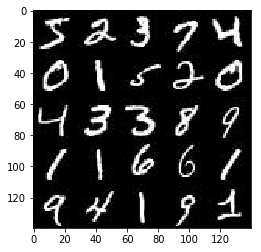

In [8]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

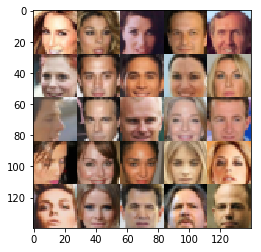

In [9]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.0.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [11]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    input_real = tf.placeholder(tf.float32, (None, image_width, image_height,image_channels), name='input_real')
    input_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    learning_rate = tf.placeholder(tf.float32, name='learning_rate')

    return input_real, input_z, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the generator, tensor logits of the generator).

In [12]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param image: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    with tf.variable_scope('discriminator', reuse=reuse):
        
        alpha = 0.2
        
        # input is 28x28
        
        x1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        #print(relu1.get_shape())
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        #print(relu2.get_shape())
        
        #x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        #bn3 = tf.layers.batch_normalization(x3, training=True)
        #relu3 = tf.maximum(alpha * bn3, bn3)
        #print(relu3.get_shape())
        
        # Flatten it
        flat = tf.reshape(relu2, (-1, 7*7*1024))
        #print(flat.get_shape())
        
        # Fully connected layer
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        #print(out.get_shape())
        
        return out, logits

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [13]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    with tf.variable_scope('generator', reuse = (not is_train)):
        
        alpha = 0.2
        
        # First fully connected layer
        x1 = tf.layers.dense(z, 7*7*1024)
        #print(x1.get_shape())
        
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 7, 7, 1024))
        # exludes BN on layer 1
        relu1 = tf.maximum(alpha * x1, x1)
        #print(relu1.get_shape())
        
        # Hidden layer 2
        x2 = tf.layers.conv2d_transpose(relu1, 512, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=is_train)
        relu2 = tf.maximum(alpha * bn2, bn2)
        #print(relu2.get_shape())
        
        # Hidden layer 3
        x3 = tf.layers.conv2d_transpose(relu2, 256, 5, strides=1, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=is_train)
        relu3 = tf.maximum(alpha * bn3, bn3)
        #print(relu2.get_shape())
        
        
        # Output layer
        logits = tf.layers.conv2d_transpose(relu3, out_channel_dim, 5, strides=2, padding='same')
        # needs to return 28x28        
        
        out = tf.tanh(logits)
        #print(out.get_shape())
        
        return out

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [14]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    g_model = generator(input_z, out_channel_dim)
    
    # Discriminator
    d_model_real, d_logits_real = discriminator(input_real)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [15]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [16]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [17]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    input_real, input_z, lr = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, data_shape[3])
    d_opt, g_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
    
    losses=[]
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            
            steps = 0
            
            for batch_images in get_batches(batch_size):
                
                # Step Counter
                steps += 1
                
                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                
                # Run Optimizer
                _ = sess.run(d_opt, feed_dict={input_real: batch_images,
                                               input_z: batch_z,
                                               lr: learning_rate})
                
                _ = sess.run(g_opt, feed_dict={input_real: batch_images,
                                               input_z: batch_z,
                                               lr: learning_rate})

                # Print loss
                if steps % 10 == 0:
                    train_loss_d = d_loss.eval({input_real: batch_images,
                                               input_z: batch_z,
                                               lr: learning_rate})
                    
                    train_loss_g = g_loss.eval({input_real: batch_images,
                                               input_z: batch_z,
                                               lr: learning_rate})
                    
                    print("Epoch {}/{}...".format(epoch_i+1, epoch_count),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    
                    losses.append((train_loss_d, train_loss_g))
                
                # Show every 100 steps
                if steps % 100 == 0:
                    #show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode)
                    show_generator_output(sess, batch_size, input_z, data_shape[3], data_image_mode)


### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 1/4... Discriminator Loss: 0.7469... Generator Loss: 0.7132
Epoch 1/4... Discriminator Loss: 20.3421... Generator Loss: 0.0000
Epoch 1/4... Discriminator Loss: 2.1233... Generator Loss: 5.8493
Epoch 1/4... Discriminator Loss: 0.4856... Generator Loss: 3.4778
Epoch 1/4... Discriminator Loss: 13.5730... Generator Loss: 0.0003
Epoch 1/4... Discriminator Loss: 2.4454... Generator Loss: 1.2940
Epoch 1/4... Discriminator Loss: 2.8512... Generator Loss: 1.4082
Epoch 1/4... Discriminator Loss: 3.9045... Generator Loss: 0.0883
Epoch 1/4... Discriminator Loss: 2.5236... Generator Loss: 0.5701
Epoch 1/4... Discriminator Loss: 0.5647... Generator Loss: 1.3560


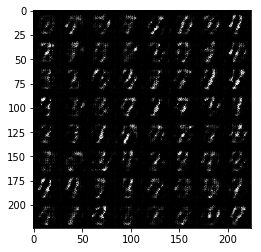

Epoch 1/4... Discriminator Loss: 0.7119... Generator Loss: 4.0489
Epoch 1/4... Discriminator Loss: 0.5099... Generator Loss: 13.2674
Epoch 1/4... Discriminator Loss: 0.0210... Generator Loss: 5.8520
Epoch 1/4... Discriminator Loss: 0.6588... Generator Loss: 1.2503
Epoch 1/4... Discriminator Loss: 4.2448... Generator Loss: 0.0198
Epoch 1/4... Discriminator Loss: 3.9311... Generator Loss: 0.0693
Epoch 1/4... Discriminator Loss: 4.5989... Generator Loss: 0.0153
Epoch 1/4... Discriminator Loss: 0.8819... Generator Loss: 1.9595
Epoch 1/4... Discriminator Loss: 0.4224... Generator Loss: 3.8073
Epoch 1/4... Discriminator Loss: 6.4845... Generator Loss: 24.2812


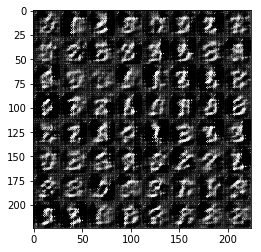

Epoch 1/4... Discriminator Loss: 0.1545... Generator Loss: 4.4341
Epoch 1/4... Discriminator Loss: 6.8278... Generator Loss: 0.0026
Epoch 1/4... Discriminator Loss: 1.4287... Generator Loss: 0.6323
Epoch 1/4... Discriminator Loss: 1.4032... Generator Loss: 1.9324
Epoch 1/4... Discriminator Loss: 1.7502... Generator Loss: 12.9489
Epoch 1/4... Discriminator Loss: 0.9861... Generator Loss: 6.8020
Epoch 1/4... Discriminator Loss: 0.0058... Generator Loss: 8.5613
Epoch 1/4... Discriminator Loss: 0.0034... Generator Loss: 8.2538
Epoch 1/4... Discriminator Loss: 0.4451... Generator Loss: 2.2649
Epoch 1/4... Discriminator Loss: 3.1454... Generator Loss: 0.2959


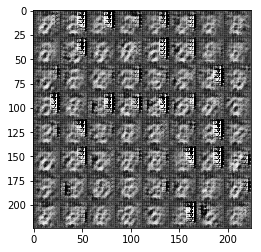

Epoch 1/4... Discriminator Loss: 1.9101... Generator Loss: 0.7432
Epoch 1/4... Discriminator Loss: 0.0280... Generator Loss: 8.7199
Epoch 1/4... Discriminator Loss: 0.0171... Generator Loss: 6.4362
Epoch 1/4... Discriminator Loss: 0.0484... Generator Loss: 8.3251
Epoch 1/4... Discriminator Loss: 0.1017... Generator Loss: 7.4718
Epoch 1/4... Discriminator Loss: 0.3233... Generator Loss: 5.0706
Epoch 1/4... Discriminator Loss: 0.0233... Generator Loss: 13.0802
Epoch 1/4... Discriminator Loss: 0.3227... Generator Loss: 3.6279
Epoch 1/4... Discriminator Loss: 0.3869... Generator Loss: 8.4521
Epoch 1/4... Discriminator Loss: 14.4861... Generator Loss: 0.0001


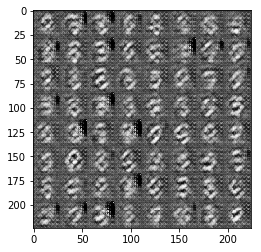

Epoch 1/4... Discriminator Loss: 14.9142... Generator Loss: 0.0000
Epoch 1/4... Discriminator Loss: 13.8399... Generator Loss: 0.0001
Epoch 1/4... Discriminator Loss: 4.5282... Generator Loss: 15.8895
Epoch 1/4... Discriminator Loss: 1.7032... Generator Loss: 1.0716
Epoch 1/4... Discriminator Loss: 2.9378... Generator Loss: 3.6348
Epoch 1/4... Discriminator Loss: 0.6023... Generator Loss: 5.2624
Epoch 1/4... Discriminator Loss: 0.7504... Generator Loss: 3.5592
Epoch 1/4... Discriminator Loss: 2.7562... Generator Loss: 0.7038
Epoch 1/4... Discriminator Loss: 0.3526... Generator Loss: 4.6520
Epoch 1/4... Discriminator Loss: 0.4148... Generator Loss: 4.8426


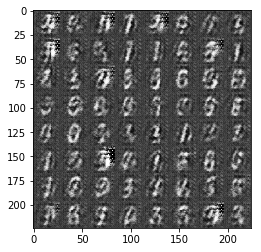

Epoch 1/4... Discriminator Loss: 0.0055... Generator Loss: 12.5408
Epoch 1/4... Discriminator Loss: 0.2448... Generator Loss: 5.6997
Epoch 1/4... Discriminator Loss: 0.3649... Generator Loss: 8.6802
Epoch 1/4... Discriminator Loss: 0.0196... Generator Loss: 5.5903
Epoch 1/4... Discriminator Loss: 0.0580... Generator Loss: 7.8803
Epoch 1/4... Discriminator Loss: 1.0048... Generator Loss: 10.0934
Epoch 1/4... Discriminator Loss: 0.1326... Generator Loss: 4.8877
Epoch 1/4... Discriminator Loss: 0.4996... Generator Loss: 7.9667
Epoch 1/4... Discriminator Loss: 3.9169... Generator Loss: 8.2818
Epoch 1/4... Discriminator Loss: 6.6420... Generator Loss: 0.0027


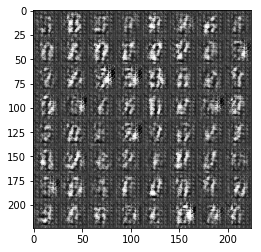

Epoch 1/4... Discriminator Loss: 1.3856... Generator Loss: 5.5653
Epoch 1/4... Discriminator Loss: 0.9910... Generator Loss: 1.7710
Epoch 1/4... Discriminator Loss: 0.6971... Generator Loss: 6.6800
Epoch 1/4... Discriminator Loss: 0.6427... Generator Loss: 3.2525
Epoch 1/4... Discriminator Loss: 1.3412... Generator Loss: 2.4960
Epoch 1/4... Discriminator Loss: 0.7072... Generator Loss: 4.2076
Epoch 1/4... Discriminator Loss: 2.1193... Generator Loss: 3.7862
Epoch 1/4... Discriminator Loss: 2.8417... Generator Loss: 0.6935
Epoch 1/4... Discriminator Loss: 0.5071... Generator Loss: 2.8801
Epoch 1/4... Discriminator Loss: 14.2665... Generator Loss: 22.9717


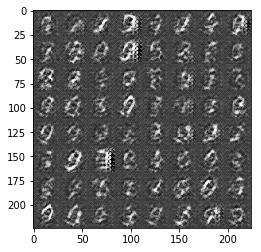

Epoch 1/4... Discriminator Loss: 3.6066... Generator Loss: 4.9362
Epoch 1/4... Discriminator Loss: 10.7185... Generator Loss: 0.0001
Epoch 1/4... Discriminator Loss: 2.4687... Generator Loss: 1.8641
Epoch 1/4... Discriminator Loss: 0.9361... Generator Loss: 1.5540
Epoch 1/4... Discriminator Loss: 2.9349... Generator Loss: 1.1988
Epoch 1/4... Discriminator Loss: 4.2404... Generator Loss: 0.3571
Epoch 1/4... Discriminator Loss: 7.2811... Generator Loss: 0.0023
Epoch 1/4... Discriminator Loss: 4.5402... Generator Loss: 0.1306
Epoch 1/4... Discriminator Loss: 1.3509... Generator Loss: 2.5583
Epoch 1/4... Discriminator Loss: 2.1949... Generator Loss: 1.0738


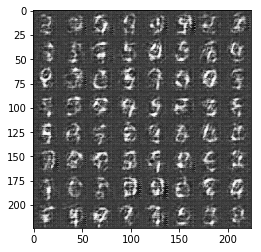

Epoch 1/4... Discriminator Loss: 3.4922... Generator Loss: 0.5526
Epoch 1/4... Discriminator Loss: 0.4931... Generator Loss: 3.2634
Epoch 1/4... Discriminator Loss: 0.2191... Generator Loss: 5.1546
Epoch 1/4... Discriminator Loss: 0.8972... Generator Loss: 1.6210
Epoch 1/4... Discriminator Loss: 1.4651... Generator Loss: 2.8652
Epoch 1/4... Discriminator Loss: 1.5973... Generator Loss: 6.7827
Epoch 1/4... Discriminator Loss: 8.8247... Generator Loss: 0.0006
Epoch 1/4... Discriminator Loss: 2.1703... Generator Loss: 4.6014
Epoch 1/4... Discriminator Loss: 0.5345... Generator Loss: 6.5242
Epoch 1/4... Discriminator Loss: 0.0332... Generator Loss: 11.5303


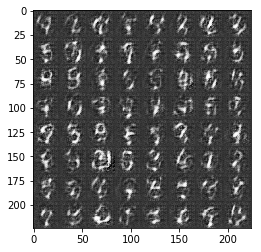

Epoch 1/4... Discriminator Loss: 5.5934... Generator Loss: 0.0343
Epoch 1/4... Discriminator Loss: 7.4412... Generator Loss: 0.0011
Epoch 1/4... Discriminator Loss: 11.2351... Generator Loss: 10.0184
Epoch 2/4... Discriminator Loss: 6.6254... Generator Loss: 0.0104
Epoch 2/4... Discriminator Loss: 2.2743... Generator Loss: 0.7567
Epoch 2/4... Discriminator Loss: 1.9687... Generator Loss: 0.9042
Epoch 2/4... Discriminator Loss: 1.2415... Generator Loss: 1.0754
Epoch 2/4... Discriminator Loss: 3.7712... Generator Loss: 0.1744
Epoch 2/4... Discriminator Loss: 0.3738... Generator Loss: 3.4082
Epoch 2/4... Discriminator Loss: 0.9107... Generator Loss: 2.2705
Epoch 2/4... Discriminator Loss: 0.2173... Generator Loss: 3.3974
Epoch 2/4... Discriminator Loss: 1.3208... Generator Loss: 1.4430
Epoch 2/4... Discriminator Loss: 1.0715... Generator Loss: 0.8104


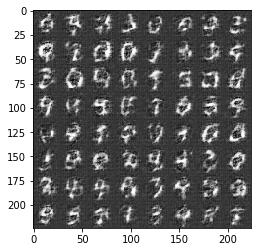

Epoch 2/4... Discriminator Loss: 1.6726... Generator Loss: 0.7743
Epoch 2/4... Discriminator Loss: 0.2582... Generator Loss: 6.4535
Epoch 2/4... Discriminator Loss: 0.5063... Generator Loss: 2.3467
Epoch 2/4... Discriminator Loss: 3.6150... Generator Loss: 0.3052
Epoch 2/4... Discriminator Loss: 2.9651... Generator Loss: 0.1308
Epoch 2/4... Discriminator Loss: 0.5943... Generator Loss: 2.8393
Epoch 2/4... Discriminator Loss: 0.2068... Generator Loss: 2.3746
Epoch 2/4... Discriminator Loss: 0.9224... Generator Loss: 7.7250
Epoch 2/4... Discriminator Loss: 5.3802... Generator Loss: 0.1470
Epoch 2/4... Discriminator Loss: 3.4654... Generator Loss: 0.1149


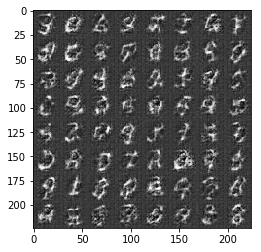

Epoch 2/4... Discriminator Loss: 0.3564... Generator Loss: 1.5747
Epoch 2/4... Discriminator Loss: 5.8845... Generator Loss: 0.0108
Epoch 2/4... Discriminator Loss: 0.6295... Generator Loss: 3.1083
Epoch 2/4... Discriminator Loss: 0.8514... Generator Loss: 2.8163
Epoch 2/4... Discriminator Loss: 3.6462... Generator Loss: 0.4492
Epoch 2/4... Discriminator Loss: 2.6788... Generator Loss: 0.1977
Epoch 2/4... Discriminator Loss: 0.7394... Generator Loss: 1.9805
Epoch 2/4... Discriminator Loss: 1.3066... Generator Loss: 0.8308
Epoch 2/4... Discriminator Loss: 8.2126... Generator Loss: 0.0026
Epoch 2/4... Discriminator Loss: 2.4403... Generator Loss: 12.8942


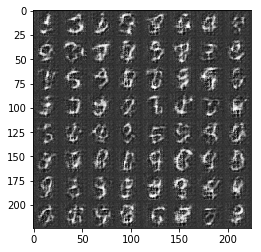

Epoch 2/4... Discriminator Loss: 1.9051... Generator Loss: 3.5754
Epoch 2/4... Discriminator Loss: 4.4595... Generator Loss: 0.0455
Epoch 2/4... Discriminator Loss: 4.0080... Generator Loss: 0.1893
Epoch 2/4... Discriminator Loss: 3.1987... Generator Loss: 0.5948
Epoch 2/4... Discriminator Loss: 1.1287... Generator Loss: 5.2557
Epoch 2/4... Discriminator Loss: 4.3310... Generator Loss: 1.0021
Epoch 2/4... Discriminator Loss: 5.1764... Generator Loss: 0.0158
Epoch 2/4... Discriminator Loss: 0.6098... Generator Loss: 3.0051
Epoch 2/4... Discriminator Loss: 2.1251... Generator Loss: 0.6881
Epoch 2/4... Discriminator Loss: 10.0084... Generator Loss: 0.0001


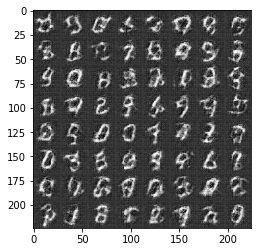

Epoch 2/4... Discriminator Loss: 1.0393... Generator Loss: 4.2656
Epoch 2/4... Discriminator Loss: 6.4785... Generator Loss: 9.6069
Epoch 2/4... Discriminator Loss: 4.0891... Generator Loss: 4.5755
Epoch 2/4... Discriminator Loss: 4.1071... Generator Loss: 0.1913
Epoch 2/4... Discriminator Loss: 3.2731... Generator Loss: 0.1200
Epoch 2/4... Discriminator Loss: 3.2053... Generator Loss: 0.9092
Epoch 2/4... Discriminator Loss: 0.0289... Generator Loss: 5.9363
Epoch 2/4... Discriminator Loss: 1.9325... Generator Loss: 0.6893
Epoch 2/4... Discriminator Loss: 0.9354... Generator Loss: 3.3039
Epoch 2/4... Discriminator Loss: 1.3230... Generator Loss: 0.8573


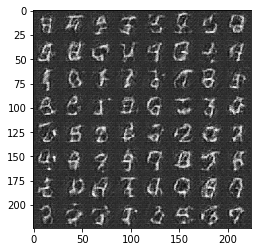

Epoch 2/4... Discriminator Loss: 4.6941... Generator Loss: 0.0326
Epoch 2/4... Discriminator Loss: 0.8000... Generator Loss: 4.8097
Epoch 2/4... Discriminator Loss: 2.6071... Generator Loss: 0.4794
Epoch 2/4... Discriminator Loss: 5.0533... Generator Loss: 0.0147
Epoch 2/4... Discriminator Loss: 2.8632... Generator Loss: 0.1481
Epoch 2/4... Discriminator Loss: 2.5065... Generator Loss: 13.3240
Epoch 2/4... Discriminator Loss: 2.6058... Generator Loss: 0.5140
Epoch 2/4... Discriminator Loss: 0.2583... Generator Loss: 2.8641
Epoch 2/4... Discriminator Loss: 1.2512... Generator Loss: 1.0734
Epoch 2/4... Discriminator Loss: 2.3624... Generator Loss: 1.3644


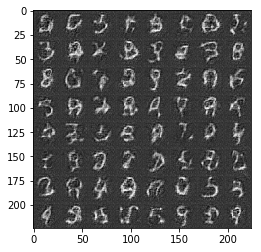

Epoch 2/4... Discriminator Loss: 1.7875... Generator Loss: 0.4356
Epoch 2/4... Discriminator Loss: 0.0583... Generator Loss: 5.0533
Epoch 2/4... Discriminator Loss: 0.1999... Generator Loss: 6.7303
Epoch 2/4... Discriminator Loss: 6.9438... Generator Loss: 0.0016
Epoch 2/4... Discriminator Loss: 0.1799... Generator Loss: 4.1244
Epoch 2/4... Discriminator Loss: 0.0982... Generator Loss: 5.0717
Epoch 2/4... Discriminator Loss: 0.1883... Generator Loss: 5.8238
Epoch 2/4... Discriminator Loss: 0.8001... Generator Loss: 0.9705
Epoch 2/4... Discriminator Loss: 0.9673... Generator Loss: 1.0429
Epoch 2/4... Discriminator Loss: 0.0271... Generator Loss: 5.3188


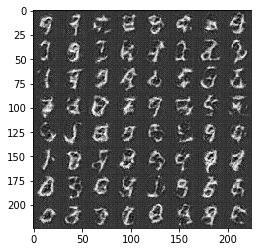

Epoch 2/4... Discriminator Loss: 0.3014... Generator Loss: 4.3784
Epoch 2/4... Discriminator Loss: 1.0148... Generator Loss: 1.0901
Epoch 2/4... Discriminator Loss: 0.9017... Generator Loss: 3.7814
Epoch 2/4... Discriminator Loss: 2.0203... Generator Loss: 0.5639
Epoch 2/4... Discriminator Loss: 0.7293... Generator Loss: 1.2254
Epoch 2/4... Discriminator Loss: 0.3671... Generator Loss: 2.5037
Epoch 2/4... Discriminator Loss: 0.8706... Generator Loss: 2.2317
Epoch 2/4... Discriminator Loss: 8.5027... Generator Loss: 12.2983
Epoch 2/4... Discriminator Loss: 10.5997... Generator Loss: 0.0001
Epoch 2/4... Discriminator Loss: 0.0453... Generator Loss: 7.1446


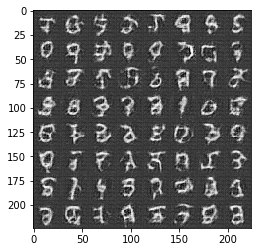

Epoch 2/4... Discriminator Loss: 7.6617... Generator Loss: 0.0058
Epoch 2/4... Discriminator Loss: 5.0858... Generator Loss: 0.0322
Epoch 2/4... Discriminator Loss: 7.2539... Generator Loss: 0.0049
Epoch 2/4... Discriminator Loss: 1.7207... Generator Loss: 3.4722
Epoch 2/4... Discriminator Loss: 4.5555... Generator Loss: 0.0290
Epoch 2/4... Discriminator Loss: 3.0293... Generator Loss: 0.3231
Epoch 2/4... Discriminator Loss: 0.5203... Generator Loss: 1.7701
Epoch 2/4... Discriminator Loss: 1.3391... Generator Loss: 0.8901
Epoch 2/4... Discriminator Loss: 8.3130... Generator Loss: 0.0007
Epoch 2/4... Discriminator Loss: 2.3160... Generator Loss: 1.0785


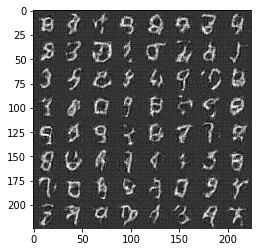

Epoch 2/4... Discriminator Loss: 1.2691... Generator Loss: 0.6037
Epoch 2/4... Discriminator Loss: 4.6202... Generator Loss: 0.0247
Epoch 2/4... Discriminator Loss: 5.8966... Generator Loss: 10.4133
Epoch 3/4... Discriminator Loss: 2.0703... Generator Loss: 0.2407
Epoch 3/4... Discriminator Loss: 7.5368... Generator Loss: 0.0014
Epoch 3/4... Discriminator Loss: 1.5278... Generator Loss: 1.4935
Epoch 3/4... Discriminator Loss: 1.6071... Generator Loss: 1.4800
Epoch 3/4... Discriminator Loss: 4.2799... Generator Loss: 0.0918
Epoch 3/4... Discriminator Loss: 0.4666... Generator Loss: 2.1966
Epoch 3/4... Discriminator Loss: 0.3926... Generator Loss: 3.7126
Epoch 3/4... Discriminator Loss: 3.2392... Generator Loss: 0.1251
Epoch 3/4... Discriminator Loss: 0.5261... Generator Loss: 1.9521
Epoch 3/4... Discriminator Loss: 1.5343... Generator Loss: 1.2070


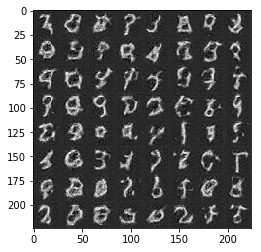

Epoch 3/4... Discriminator Loss: 2.1972... Generator Loss: 2.2224
Epoch 3/4... Discriminator Loss: 0.9279... Generator Loss: 1.4722
Epoch 3/4... Discriminator Loss: 0.1175... Generator Loss: 4.0232
Epoch 3/4... Discriminator Loss: 0.8959... Generator Loss: 1.5593
Epoch 3/4... Discriminator Loss: 3.6332... Generator Loss: 9.3235
Epoch 3/4... Discriminator Loss: 6.2238... Generator Loss: 0.2577
Epoch 3/4... Discriminator Loss: 3.2505... Generator Loss: 0.3016
Epoch 3/4... Discriminator Loss: 6.2355... Generator Loss: 0.1024
Epoch 3/4... Discriminator Loss: 3.1764... Generator Loss: 0.2674
Epoch 3/4... Discriminator Loss: 0.9162... Generator Loss: 1.5335


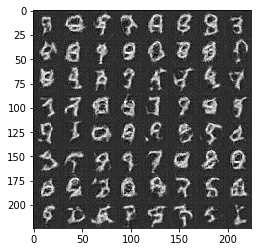

Epoch 3/4... Discriminator Loss: 1.5739... Generator Loss: 1.5462
Epoch 3/4... Discriminator Loss: 2.6517... Generator Loss: 0.8048
Epoch 3/4... Discriminator Loss: 2.6697... Generator Loss: 1.8124
Epoch 3/4... Discriminator Loss: 0.2826... Generator Loss: 3.6838
Epoch 3/4... Discriminator Loss: 2.7857... Generator Loss: 0.7727
Epoch 3/4... Discriminator Loss: 7.3185... Generator Loss: 0.0013
Epoch 3/4... Discriminator Loss: 4.9576... Generator Loss: 0.1773
Epoch 3/4... Discriminator Loss: 0.9365... Generator Loss: 2.9249
Epoch 3/4... Discriminator Loss: 3.4756... Generator Loss: 0.3330
Epoch 3/4... Discriminator Loss: 0.3691... Generator Loss: 2.0598


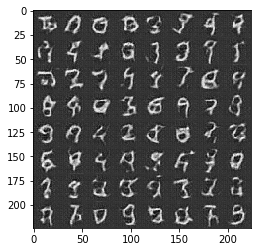

Epoch 3/4... Discriminator Loss: 3.9909... Generator Loss: 0.0324
Epoch 3/4... Discriminator Loss: 0.9227... Generator Loss: 1.9562
Epoch 3/4... Discriminator Loss: 1.9518... Generator Loss: 0.9985
Epoch 3/4... Discriminator Loss: 1.6200... Generator Loss: 0.8767
Epoch 3/4... Discriminator Loss: 3.1184... Generator Loss: 0.8316
Epoch 3/4... Discriminator Loss: 1.8334... Generator Loss: 0.6180
Epoch 3/4... Discriminator Loss: 2.9701... Generator Loss: 1.1054
Epoch 3/4... Discriminator Loss: 3.6450... Generator Loss: 0.3892
Epoch 3/4... Discriminator Loss: 2.4336... Generator Loss: 0.8685
Epoch 3/4... Discriminator Loss: 0.7022... Generator Loss: 1.5544


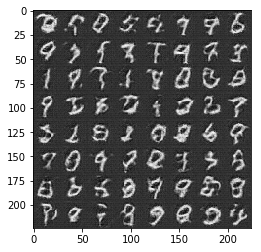

Epoch 3/4... Discriminator Loss: 1.6219... Generator Loss: 1.3900
Epoch 3/4... Discriminator Loss: 6.2785... Generator Loss: 0.0216
Epoch 3/4... Discriminator Loss: 6.8201... Generator Loss: 0.1048
Epoch 3/4... Discriminator Loss: 4.1920... Generator Loss: 0.2706
Epoch 3/4... Discriminator Loss: 3.1489... Generator Loss: 0.2999
Epoch 3/4... Discriminator Loss: 2.2714... Generator Loss: 2.7393
Epoch 3/4... Discriminator Loss: 0.3806... Generator Loss: 4.5009
Epoch 3/4... Discriminator Loss: 2.5903... Generator Loss: 0.9039
Epoch 3/4... Discriminator Loss: 0.3372... Generator Loss: 2.0967
Epoch 3/4... Discriminator Loss: 1.5226... Generator Loss: 0.9176


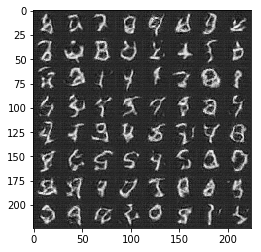

Epoch 3/4... Discriminator Loss: 6.9754... Generator Loss: 0.0039
Epoch 3/4... Discriminator Loss: 1.6419... Generator Loss: 1.6758
Epoch 3/4... Discriminator Loss: 0.3667... Generator Loss: 3.7718
Epoch 3/4... Discriminator Loss: 4.3698... Generator Loss: 0.0590
Epoch 3/4... Discriminator Loss: 0.8895... Generator Loss: 1.3450
Epoch 3/4... Discriminator Loss: 1.7462... Generator Loss: 6.7630
Epoch 3/4... Discriminator Loss: 0.6426... Generator Loss: 1.5925
Epoch 3/4... Discriminator Loss: 1.2980... Generator Loss: 1.2307
Epoch 3/4... Discriminator Loss: 5.1974... Generator Loss: 0.0704
Epoch 3/4... Discriminator Loss: 5.7138... Generator Loss: 0.0071


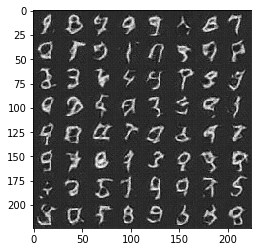

Epoch 3/4... Discriminator Loss: 1.3576... Generator Loss: 1.5691
Epoch 3/4... Discriminator Loss: 0.1676... Generator Loss: 4.1573
Epoch 3/4... Discriminator Loss: 0.2549... Generator Loss: 5.8910
Epoch 3/4... Discriminator Loss: 4.1751... Generator Loss: 0.0878
Epoch 3/4... Discriminator Loss: 2.1875... Generator Loss: 0.9933
Epoch 3/4... Discriminator Loss: 0.5135... Generator Loss: 3.1265
Epoch 3/4... Discriminator Loss: 0.4834... Generator Loss: 3.0344
Epoch 3/4... Discriminator Loss: 2.1524... Generator Loss: 0.2817
Epoch 3/4... Discriminator Loss: 0.4116... Generator Loss: 2.7861
Epoch 3/4... Discriminator Loss: 3.5941... Generator Loss: 0.0975


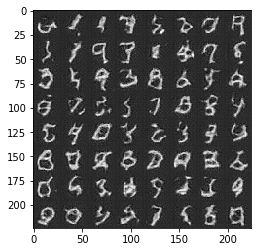

Epoch 3/4... Discriminator Loss: 0.2288... Generator Loss: 2.9394
Epoch 3/4... Discriminator Loss: 0.2870... Generator Loss: 3.8180
Epoch 3/4... Discriminator Loss: 3.4516... Generator Loss: 0.2039
Epoch 3/4... Discriminator Loss: 2.8979... Generator Loss: 0.1873
Epoch 3/4... Discriminator Loss: 0.8154... Generator Loss: 6.0116
Epoch 3/4... Discriminator Loss: 10.0895... Generator Loss: 0.4015
Epoch 3/4... Discriminator Loss: 8.0593... Generator Loss: 0.0019
Epoch 3/4... Discriminator Loss: 6.5225... Generator Loss: 11.4488
Epoch 3/4... Discriminator Loss: 1.6562... Generator Loss: 1.3519
Epoch 3/4... Discriminator Loss: 5.1733... Generator Loss: 0.0505


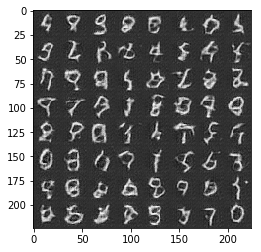

Epoch 3/4... Discriminator Loss: 4.1247... Generator Loss: 0.0550
Epoch 3/4... Discriminator Loss: 7.0918... Generator Loss: 0.0016
Epoch 3/4... Discriminator Loss: 5.8706... Generator Loss: 0.1437
Epoch 3/4... Discriminator Loss: 2.9734... Generator Loss: 0.9058
Epoch 3/4... Discriminator Loss: 4.4810... Generator Loss: 0.1180
Epoch 3/4... Discriminator Loss: 2.2625... Generator Loss: 1.5651
Epoch 3/4... Discriminator Loss: 0.6540... Generator Loss: 2.9889
Epoch 3/4... Discriminator Loss: 1.7532... Generator Loss: 0.5166
Epoch 3/4... Discriminator Loss: 0.6155... Generator Loss: 2.4680
Epoch 3/4... Discriminator Loss: 0.0988... Generator Loss: 4.4202


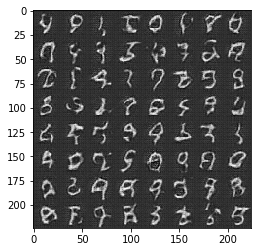

Epoch 3/4... Discriminator Loss: 1.6133... Generator Loss: 1.1603
Epoch 3/4... Discriminator Loss: 7.2752... Generator Loss: 0.0040
Epoch 3/4... Discriminator Loss: 3.5628... Generator Loss: 1.5734
Epoch 4/4... Discriminator Loss: 4.6956... Generator Loss: 0.3594
Epoch 4/4... Discriminator Loss: 4.9470... Generator Loss: 0.1725
Epoch 4/4... Discriminator Loss: 3.6069... Generator Loss: 0.1169
Epoch 4/4... Discriminator Loss: 4.6462... Generator Loss: 0.2620
Epoch 4/4... Discriminator Loss: 2.5023... Generator Loss: 0.8122
Epoch 4/4... Discriminator Loss: 1.4599... Generator Loss: 0.6808
Epoch 4/4... Discriminator Loss: 2.2972... Generator Loss: 1.3182
Epoch 4/4... Discriminator Loss: 1.8912... Generator Loss: 0.6331
Epoch 4/4... Discriminator Loss: 3.6245... Generator Loss: 0.2958
Epoch 4/4... Discriminator Loss: 0.5533... Generator Loss: 2.4509


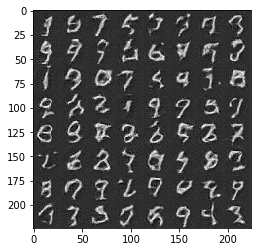

Epoch 4/4... Discriminator Loss: 1.7149... Generator Loss: 1.1607
Epoch 4/4... Discriminator Loss: 1.5939... Generator Loss: 3.0891
Epoch 4/4... Discriminator Loss: 0.6147... Generator Loss: 2.9085
Epoch 4/4... Discriminator Loss: 1.8041... Generator Loss: 2.7279
Epoch 4/4... Discriminator Loss: 6.8374... Generator Loss: 8.8821
Epoch 4/4... Discriminator Loss: 4.4268... Generator Loss: 0.0766
Epoch 4/4... Discriminator Loss: 4.0424... Generator Loss: 0.4261
Epoch 4/4... Discriminator Loss: 4.2385... Generator Loss: 0.4120
Epoch 4/4... Discriminator Loss: 1.2092... Generator Loss: 3.8121
Epoch 4/4... Discriminator Loss: 4.4540... Generator Loss: 0.0426


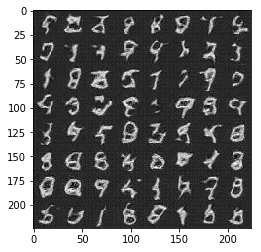

Epoch 4/4... Discriminator Loss: 1.4577... Generator Loss: 1.3022
Epoch 4/4... Discriminator Loss: 4.4416... Generator Loss: 0.1932
Epoch 4/4... Discriminator Loss: 0.9040... Generator Loss: 10.5910
Epoch 4/4... Discriminator Loss: 2.4186... Generator Loss: 0.7498
Epoch 4/4... Discriminator Loss: 2.6954... Generator Loss: 0.6807
Epoch 4/4... Discriminator Loss: 6.8980... Generator Loss: 0.0036
Epoch 4/4... Discriminator Loss: 1.7217... Generator Loss: 0.7495
Epoch 4/4... Discriminator Loss: 2.9320... Generator Loss: 1.4118
Epoch 4/4... Discriminator Loss: 7.1922... Generator Loss: 0.0057
Epoch 4/4... Discriminator Loss: 3.5299... Generator Loss: 0.9524


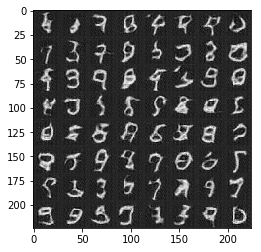

Epoch 4/4... Discriminator Loss: 3.6672... Generator Loss: 8.0224
Epoch 4/4... Discriminator Loss: 0.9743... Generator Loss: 1.5495
Epoch 4/4... Discriminator Loss: 0.5208... Generator Loss: 1.6499
Epoch 4/4... Discriminator Loss: 0.7605... Generator Loss: 2.1238
Epoch 4/4... Discriminator Loss: 2.6779... Generator Loss: 0.9588
Epoch 4/4... Discriminator Loss: 1.0286... Generator Loss: 1.2526
Epoch 4/4... Discriminator Loss: 1.0065... Generator Loss: 2.8354
Epoch 4/4... Discriminator Loss: 1.4993... Generator Loss: 1.3032
Epoch 4/4... Discriminator Loss: 1.7720... Generator Loss: 0.3709
Epoch 4/4... Discriminator Loss: 2.4542... Generator Loss: 2.4586


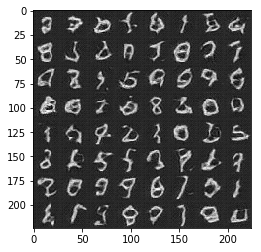

Epoch 4/4... Discriminator Loss: 1.1398... Generator Loss: 1.9700
Epoch 4/4... Discriminator Loss: 5.4983... Generator Loss: 0.0384
Epoch 4/4... Discriminator Loss: 4.8916... Generator Loss: 0.0669
Epoch 4/4... Discriminator Loss: 3.2570... Generator Loss: 0.7064
Epoch 4/4... Discriminator Loss: 1.6517... Generator Loss: 1.6439
Epoch 4/4... Discriminator Loss: 1.2064... Generator Loss: 1.6087
Epoch 4/4... Discriminator Loss: 0.0586... Generator Loss: 6.9987
Epoch 4/4... Discriminator Loss: 4.6512... Generator Loss: 0.4111
Epoch 4/4... Discriminator Loss: 0.3231... Generator Loss: 2.7774
Epoch 4/4... Discriminator Loss: 0.0050... Generator Loss: 7.3609


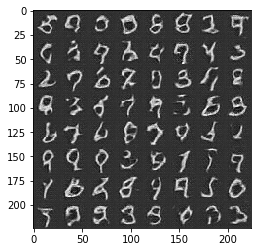

Epoch 4/4... Discriminator Loss: 1.0990... Generator Loss: 5.5509
Epoch 4/4... Discriminator Loss: 8.2702... Generator Loss: 0.0008
Epoch 4/4... Discriminator Loss: 3.4225... Generator Loss: 0.5910
Epoch 4/4... Discriminator Loss: 3.2641... Generator Loss: 0.2363
Epoch 4/4... Discriminator Loss: 0.8712... Generator Loss: 1.9484
Epoch 4/4... Discriminator Loss: 2.3461... Generator Loss: 4.6127
Epoch 4/4... Discriminator Loss: 0.5192... Generator Loss: 2.3366
Epoch 4/4... Discriminator Loss: 0.6167... Generator Loss: 3.1522
Epoch 4/4... Discriminator Loss: 1.2735... Generator Loss: 1.4223
Epoch 4/4... Discriminator Loss: 4.1194... Generator Loss: 1.1864


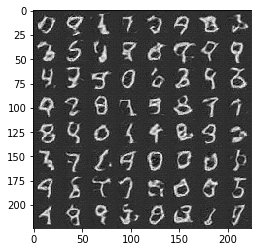

Epoch 4/4... Discriminator Loss: 0.3103... Generator Loss: 3.7869
Epoch 4/4... Discriminator Loss: 1.0643... Generator Loss: 1.7298
Epoch 4/4... Discriminator Loss: 1.5170... Generator Loss: 2.1047
Epoch 4/4... Discriminator Loss: 6.1774... Generator Loss: 0.5147
Epoch 4/4... Discriminator Loss: 1.1099... Generator Loss: 1.9817
Epoch 4/4... Discriminator Loss: 0.0094... Generator Loss: 6.1805
Epoch 4/4... Discriminator Loss: 3.1843... Generator Loss: 0.4313
Epoch 4/4... Discriminator Loss: 1.0882... Generator Loss: 2.6243
Epoch 4/4... Discriminator Loss: 1.9184... Generator Loss: 0.6800
Epoch 4/4... Discriminator Loss: 6.2227... Generator Loss: 0.0885


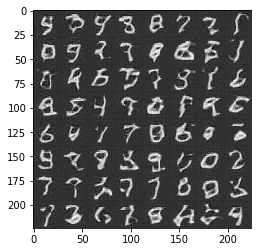

Epoch 4/4... Discriminator Loss: 5.2062... Generator Loss: 15.0176
Epoch 4/4... Discriminator Loss: 9.0598... Generator Loss: 0.0026
Epoch 4/4... Discriminator Loss: 7.4302... Generator Loss: 0.0085
Epoch 4/4... Discriminator Loss: 6.0631... Generator Loss: 0.0211
Epoch 4/4... Discriminator Loss: 2.1687... Generator Loss: 0.8735
Epoch 4/4... Discriminator Loss: 5.7015... Generator Loss: 0.0393
Epoch 4/4... Discriminator Loss: 4.2476... Generator Loss: 1.1534
Epoch 4/4... Discriminator Loss: 9.0014... Generator Loss: 0.0003
Epoch 4/4... Discriminator Loss: 4.9447... Generator Loss: 0.1846
Epoch 4/4... Discriminator Loss: 0.3615... Generator Loss: 6.6713


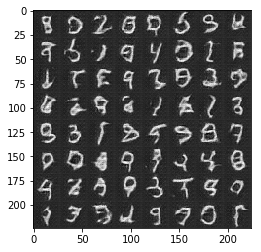

Epoch 4/4... Discriminator Loss: 5.3102... Generator Loss: 0.1276
Epoch 4/4... Discriminator Loss: 5.1327... Generator Loss: 0.0482
Epoch 4/4... Discriminator Loss: 1.7025... Generator Loss: 1.7687
Epoch 4/4... Discriminator Loss: 4.7093... Generator Loss: 0.2120
Epoch 4/4... Discriminator Loss: 1.8588... Generator Loss: 4.3930
Epoch 4/4... Discriminator Loss: 3.4708... Generator Loss: 0.5152
Epoch 4/4... Discriminator Loss: 3.3624... Generator Loss: 0.3054
Epoch 4/4... Discriminator Loss: 3.4128... Generator Loss: 0.1423
Epoch 4/4... Discriminator Loss: 1.1498... Generator Loss: 1.4664
Epoch 4/4... Discriminator Loss: 4.4574... Generator Loss: 0.1651


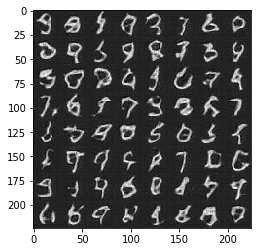

Epoch 4/4... Discriminator Loss: 8.6379... Generator Loss: 0.0011
Epoch 4/4... Discriminator Loss: 8.4402... Generator Loss: 0.0023
Epoch 4/4... Discriminator Loss: 6.0293... Generator Loss: 0.0099


In [18]:
batch_size = 64
z_dim = 200
learning_rate = 0.001
beta1 = 0.3



"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 4

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/4... Discriminator Loss: 12.8448... Generator Loss: 0.0000
Epoch 1/4... Discriminator Loss: 0.9719... Generator Loss: 1.0051
Epoch 1/4... Discriminator Loss: 0.3655... Generator Loss: 1.5294
Epoch 1/4... Discriminator Loss: 1.7115... Generator Loss: 11.5227
Epoch 1/4... Discriminator Loss: 0.0167... Generator Loss: 5.4222
Epoch 1/4... Discriminator Loss: 0.0337... Generator Loss: 5.6250
Epoch 1/4... Discriminator Loss: 0.0026... Generator Loss: 7.5033
Epoch 1/4... Discriminator Loss: 0.0083... Generator Loss: 6.7336
Epoch 1/4... Discriminator Loss: 0.0057... Generator Loss: 12.2717
Epoch 1/4... Discriminator Loss: 0.0110... Generator Loss: 5.8319


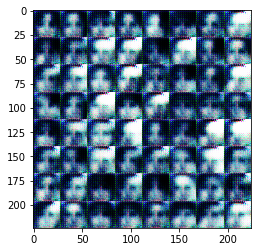

Epoch 1/4... Discriminator Loss: 0.0150... Generator Loss: 21.7597
Epoch 1/4... Discriminator Loss: 0.8271... Generator Loss: 0.7316
Epoch 1/4... Discriminator Loss: 2.9778... Generator Loss: 0.6413
Epoch 1/4... Discriminator Loss: 2.6219... Generator Loss: 0.2673
Epoch 1/4... Discriminator Loss: 0.7927... Generator Loss: 3.4852
Epoch 1/4... Discriminator Loss: 0.1747... Generator Loss: 2.7990
Epoch 1/4... Discriminator Loss: 1.0351... Generator Loss: 1.2906
Epoch 1/4... Discriminator Loss: 0.2067... Generator Loss: 5.5046
Epoch 1/4... Discriminator Loss: 0.4748... Generator Loss: 2.1394
Epoch 1/4... Discriminator Loss: 0.0215... Generator Loss: 8.6007


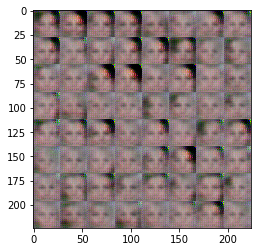

Epoch 1/4... Discriminator Loss: 1.2163... Generator Loss: 3.0620
Epoch 1/4... Discriminator Loss: 3.1623... Generator Loss: 0.7345
Epoch 1/4... Discriminator Loss: 1.2270... Generator Loss: 4.7032
Epoch 1/4... Discriminator Loss: 0.0146... Generator Loss: 9.0984
Epoch 1/4... Discriminator Loss: 0.0281... Generator Loss: 14.6779
Epoch 1/4... Discriminator Loss: 0.3635... Generator Loss: 8.9786
Epoch 1/4... Discriminator Loss: 1.0358... Generator Loss: 5.3518
Epoch 1/4... Discriminator Loss: 0.3075... Generator Loss: 3.1234
Epoch 1/4... Discriminator Loss: 0.0213... Generator Loss: 9.4326
Epoch 1/4... Discriminator Loss: 0.8471... Generator Loss: 1.2072


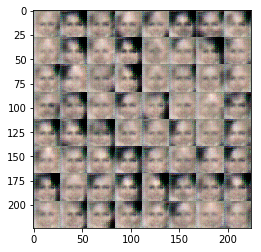

Epoch 1/4... Discriminator Loss: 2.4724... Generator Loss: 0.8931
Epoch 1/4... Discriminator Loss: 0.8125... Generator Loss: 1.4190
Epoch 1/4... Discriminator Loss: 3.4765... Generator Loss: 0.1590
Epoch 1/4... Discriminator Loss: 0.5281... Generator Loss: 2.3112
Epoch 1/4... Discriminator Loss: 0.6948... Generator Loss: 1.1201
Epoch 1/4... Discriminator Loss: 1.2452... Generator Loss: 1.5841
Epoch 1/4... Discriminator Loss: 6.3238... Generator Loss: 12.1953
Epoch 1/4... Discriminator Loss: 4.2067... Generator Loss: 0.0823
Epoch 1/4... Discriminator Loss: 0.9091... Generator Loss: 4.2229
Epoch 1/4... Discriminator Loss: 2.1596... Generator Loss: 0.2901


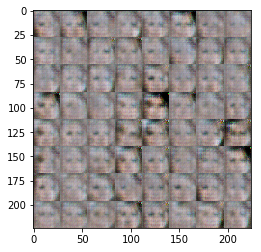

Epoch 1/4... Discriminator Loss: 0.7806... Generator Loss: 2.2563
Epoch 1/4... Discriminator Loss: 0.7652... Generator Loss: 6.4644
Epoch 1/4... Discriminator Loss: 0.9813... Generator Loss: 1.7686
Epoch 1/4... Discriminator Loss: 0.4086... Generator Loss: 2.6720
Epoch 1/4... Discriminator Loss: 0.5796... Generator Loss: 2.0763
Epoch 1/4... Discriminator Loss: 0.5258... Generator Loss: 7.9411
Epoch 1/4... Discriminator Loss: 4.6041... Generator Loss: 7.1082
Epoch 1/4... Discriminator Loss: 4.4381... Generator Loss: 0.6979
Epoch 1/4... Discriminator Loss: 1.0742... Generator Loss: 1.8938
Epoch 1/4... Discriminator Loss: 1.1702... Generator Loss: 3.8793


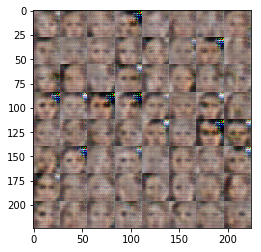

Epoch 1/4... Discriminator Loss: 0.9092... Generator Loss: 0.7884
Epoch 1/4... Discriminator Loss: 0.1106... Generator Loss: 4.6532
Epoch 1/4... Discriminator Loss: 0.4113... Generator Loss: 4.4885
Epoch 1/4... Discriminator Loss: 1.1087... Generator Loss: 2.4699
Epoch 1/4... Discriminator Loss: 0.8873... Generator Loss: 1.8914
Epoch 1/4... Discriminator Loss: 2.5161... Generator Loss: 5.4011
Epoch 1/4... Discriminator Loss: 2.3401... Generator Loss: 0.2855
Epoch 1/4... Discriminator Loss: 1.1442... Generator Loss: 1.0678
Epoch 1/4... Discriminator Loss: 0.1482... Generator Loss: 5.9563
Epoch 1/4... Discriminator Loss: 0.4516... Generator Loss: 5.8396


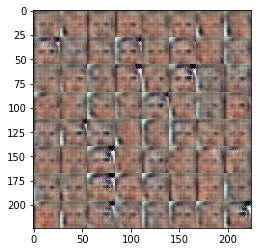

Epoch 1/4... Discriminator Loss: 0.0488... Generator Loss: 3.7827
Epoch 1/4... Discriminator Loss: 4.1106... Generator Loss: 0.2731
Epoch 1/4... Discriminator Loss: 3.0666... Generator Loss: 0.2080
Epoch 1/4... Discriminator Loss: 6.1715... Generator Loss: 0.0086
Epoch 1/4... Discriminator Loss: 2.1509... Generator Loss: 4.9008
Epoch 1/4... Discriminator Loss: 0.1146... Generator Loss: 6.6802
Epoch 1/4... Discriminator Loss: 0.8064... Generator Loss: 1.5280
Epoch 1/4... Discriminator Loss: 1.5997... Generator Loss: 0.3089
Epoch 1/4... Discriminator Loss: 1.8765... Generator Loss: 2.3663
Epoch 1/4... Discriminator Loss: 0.0873... Generator Loss: 9.8001


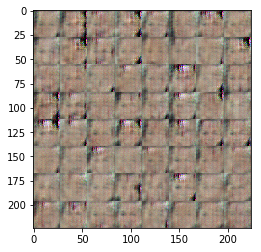

Epoch 1/4... Discriminator Loss: 1.3873... Generator Loss: 0.8950
Epoch 1/4... Discriminator Loss: 0.1667... Generator Loss: 4.0275
Epoch 1/4... Discriminator Loss: 1.4376... Generator Loss: 7.4106
Epoch 1/4... Discriminator Loss: 4.1069... Generator Loss: 0.0286
Epoch 1/4... Discriminator Loss: 0.1848... Generator Loss: 6.0452
Epoch 1/4... Discriminator Loss: 5.7771... Generator Loss: 5.6574
Epoch 1/4... Discriminator Loss: 2.7819... Generator Loss: 0.2494
Epoch 1/4... Discriminator Loss: 1.5421... Generator Loss: 0.6907
Epoch 1/4... Discriminator Loss: 0.0837... Generator Loss: 5.3239
Epoch 1/4... Discriminator Loss: 2.3414... Generator Loss: 10.4750


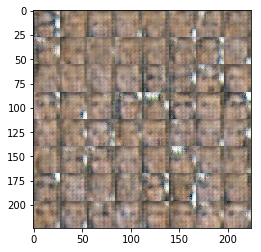

Epoch 1/4... Discriminator Loss: 1.7925... Generator Loss: 15.5143
Epoch 1/4... Discriminator Loss: 1.4140... Generator Loss: 0.3978
Epoch 1/4... Discriminator Loss: 2.9022... Generator Loss: 0.1634
Epoch 1/4... Discriminator Loss: 0.4652... Generator Loss: 2.2493
Epoch 1/4... Discriminator Loss: 1.1627... Generator Loss: 0.6982
Epoch 1/4... Discriminator Loss: 5.3105... Generator Loss: 0.0093
Epoch 1/4... Discriminator Loss: 3.3334... Generator Loss: 0.0407
Epoch 1/4... Discriminator Loss: 1.8713... Generator Loss: 0.6102
Epoch 1/4... Discriminator Loss: 3.8300... Generator Loss: 0.0779
Epoch 1/4... Discriminator Loss: 1.0259... Generator Loss: 2.3091


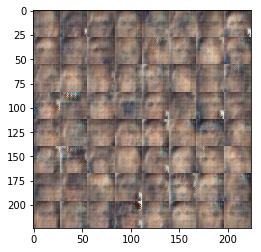

Epoch 1/4... Discriminator Loss: 1.3591... Generator Loss: 0.4590
Epoch 1/4... Discriminator Loss: 4.4550... Generator Loss: 8.9517
Epoch 1/4... Discriminator Loss: 0.8358... Generator Loss: 2.4823
Epoch 1/4... Discriminator Loss: 1.0083... Generator Loss: 1.5725
Epoch 1/4... Discriminator Loss: 0.4202... Generator Loss: 2.4731
Epoch 1/4... Discriminator Loss: 0.0085... Generator Loss: 8.7202
Epoch 1/4... Discriminator Loss: 0.0401... Generator Loss: 7.2943
Epoch 1/4... Discriminator Loss: 0.2819... Generator Loss: 4.2421
Epoch 1/4... Discriminator Loss: 0.8284... Generator Loss: 1.6258
Epoch 1/4... Discriminator Loss: 0.0400... Generator Loss: 12.1610


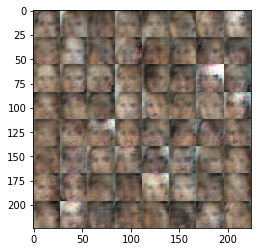

Epoch 1/4... Discriminator Loss: 0.1265... Generator Loss: 3.7377
Epoch 1/4... Discriminator Loss: 0.3035... Generator Loss: 2.5659
Epoch 1/4... Discriminator Loss: 8.1732... Generator Loss: 0.0048
Epoch 1/4... Discriminator Loss: 0.4537... Generator Loss: 3.9136
Epoch 1/4... Discriminator Loss: 3.2571... Generator Loss: 0.0846
Epoch 1/4... Discriminator Loss: 8.5363... Generator Loss: 4.2693
Epoch 1/4... Discriminator Loss: 3.1942... Generator Loss: 4.5170
Epoch 1/4... Discriminator Loss: 4.7014... Generator Loss: 0.0135
Epoch 1/4... Discriminator Loss: 1.9505... Generator Loss: 4.5628
Epoch 1/4... Discriminator Loss: 4.6629... Generator Loss: 9.4678


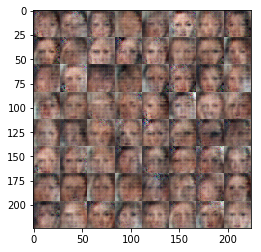

Epoch 1/4... Discriminator Loss: 1.5630... Generator Loss: 1.1285
Epoch 1/4... Discriminator Loss: 2.2338... Generator Loss: 6.9967
Epoch 1/4... Discriminator Loss: 0.1458... Generator Loss: 8.8363
Epoch 1/4... Discriminator Loss: 1.1642... Generator Loss: 1.4675
Epoch 1/4... Discriminator Loss: 1.7796... Generator Loss: 0.5394
Epoch 1/4... Discriminator Loss: 0.0220... Generator Loss: 16.0230
Epoch 1/4... Discriminator Loss: 0.2488... Generator Loss: 3.0766
Epoch 1/4... Discriminator Loss: 4.1067... Generator Loss: 0.0216
Epoch 1/4... Discriminator Loss: 2.6500... Generator Loss: 0.0819
Epoch 1/4... Discriminator Loss: 1.3304... Generator Loss: 0.4990


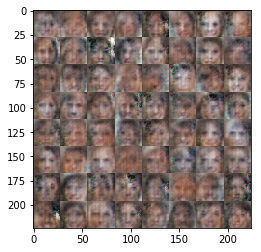

Epoch 1/4... Discriminator Loss: 0.6454... Generator Loss: 3.6512
Epoch 1/4... Discriminator Loss: 2.9855... Generator Loss: 1.4361
Epoch 1/4... Discriminator Loss: 0.2304... Generator Loss: 6.1753
Epoch 1/4... Discriminator Loss: 0.2570... Generator Loss: 5.6343
Epoch 1/4... Discriminator Loss: 0.2055... Generator Loss: 7.1661
Epoch 1/4... Discriminator Loss: 0.5287... Generator Loss: 2.1728
Epoch 1/4... Discriminator Loss: 4.4701... Generator Loss: 0.0360
Epoch 1/4... Discriminator Loss: 0.9258... Generator Loss: 2.7316
Epoch 1/4... Discriminator Loss: 0.9338... Generator Loss: 0.6712
Epoch 1/4... Discriminator Loss: 3.1719... Generator Loss: 0.0792


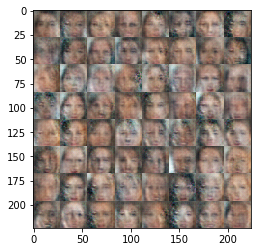

Epoch 1/4... Discriminator Loss: 3.4100... Generator Loss: 0.0418
Epoch 1/4... Discriminator Loss: 7.3319... Generator Loss: 0.0010
Epoch 1/4... Discriminator Loss: 3.4325... Generator Loss: 0.0587
Epoch 1/4... Discriminator Loss: 3.2564... Generator Loss: 0.0680
Epoch 1/4... Discriminator Loss: 3.1299... Generator Loss: 4.4251
Epoch 1/4... Discriminator Loss: 1.3725... Generator Loss: 0.4988
Epoch 1/4... Discriminator Loss: 2.2540... Generator Loss: 0.1419
Epoch 1/4... Discriminator Loss: 4.5737... Generator Loss: 0.0207
Epoch 1/4... Discriminator Loss: 4.4711... Generator Loss: 0.0217
Epoch 1/4... Discriminator Loss: 4.7672... Generator Loss: 0.0142


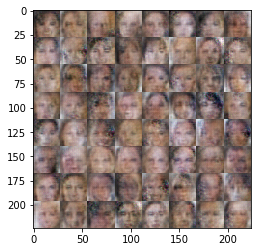

Epoch 1/4... Discriminator Loss: 2.1234... Generator Loss: 3.4430
Epoch 1/4... Discriminator Loss: 0.9409... Generator Loss: 0.9096
Epoch 1/4... Discriminator Loss: 2.0356... Generator Loss: 0.2473
Epoch 1/4... Discriminator Loss: 2.0355... Generator Loss: 0.3727
Epoch 1/4... Discriminator Loss: 2.9401... Generator Loss: 0.1651
Epoch 1/4... Discriminator Loss: 4.0462... Generator Loss: 0.0209
Epoch 1/4... Discriminator Loss: 1.1387... Generator Loss: 0.9958
Epoch 1/4... Discriminator Loss: 0.5645... Generator Loss: 2.2673
Epoch 1/4... Discriminator Loss: 6.0618... Generator Loss: 0.0042
Epoch 1/4... Discriminator Loss: 1.4750... Generator Loss: 0.4715


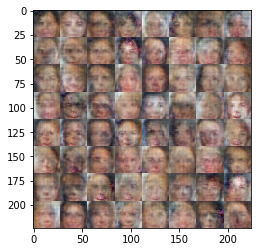

Epoch 1/4... Discriminator Loss: 0.0725... Generator Loss: 8.8505
Epoch 1/4... Discriminator Loss: 1.1625... Generator Loss: 0.4272
Epoch 1/4... Discriminator Loss: 0.4354... Generator Loss: 5.0528
Epoch 1/4... Discriminator Loss: 4.4144... Generator Loss: 0.0167
Epoch 1/4... Discriminator Loss: 1.2454... Generator Loss: 3.1545
Epoch 1/4... Discriminator Loss: 1.9023... Generator Loss: 2.4517
Epoch 1/4... Discriminator Loss: 1.2440... Generator Loss: 1.0657
Epoch 1/4... Discriminator Loss: 0.8427... Generator Loss: 1.1821
Epoch 1/4... Discriminator Loss: 1.1798... Generator Loss: 0.9617
Epoch 1/4... Discriminator Loss: 2.5157... Generator Loss: 0.0949


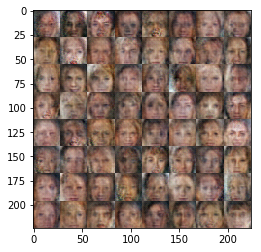

Epoch 1/4... Discriminator Loss: 1.7882... Generator Loss: 0.2552
Epoch 1/4... Discriminator Loss: 1.4387... Generator Loss: 1.1964
Epoch 1/4... Discriminator Loss: 1.9900... Generator Loss: 0.2573
Epoch 1/4... Discriminator Loss: 2.8561... Generator Loss: 0.0694
Epoch 1/4... Discriminator Loss: 1.1145... Generator Loss: 0.5351
Epoch 1/4... Discriminator Loss: 3.8427... Generator Loss: 0.0360
Epoch 1/4... Discriminator Loss: 2.2178... Generator Loss: 0.1476
Epoch 1/4... Discriminator Loss: 0.7880... Generator Loss: 0.9049
Epoch 1/4... Discriminator Loss: 0.8839... Generator Loss: 0.8982
Epoch 1/4... Discriminator Loss: 0.9084... Generator Loss: 1.6809


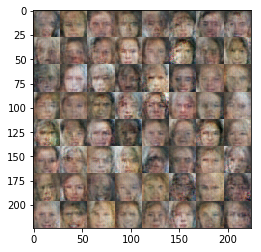

Epoch 1/4... Discriminator Loss: 1.7733... Generator Loss: 0.2302
Epoch 1/4... Discriminator Loss: 4.4566... Generator Loss: 0.0240
Epoch 1/4... Discriminator Loss: 4.4242... Generator Loss: 0.0186
Epoch 1/4... Discriminator Loss: 1.5365... Generator Loss: 2.1471
Epoch 1/4... Discriminator Loss: 1.0304... Generator Loss: 1.2032
Epoch 1/4... Discriminator Loss: 1.3539... Generator Loss: 0.6278
Epoch 1/4... Discriminator Loss: 1.2885... Generator Loss: 1.5547
Epoch 1/4... Discriminator Loss: 2.7824... Generator Loss: 0.0676
Epoch 1/4... Discriminator Loss: 1.1839... Generator Loss: 0.5988
Epoch 1/4... Discriminator Loss: 1.1571... Generator Loss: 0.8062


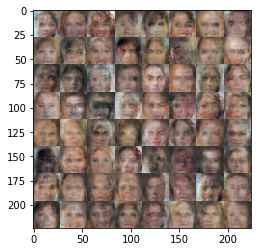

Epoch 1/4... Discriminator Loss: 1.7870... Generator Loss: 0.2794
Epoch 1/4... Discriminator Loss: 2.0990... Generator Loss: 0.1959
Epoch 1/4... Discriminator Loss: 4.3387... Generator Loss: 0.0144
Epoch 1/4... Discriminator Loss: 4.2458... Generator Loss: 4.0721
Epoch 1/4... Discriminator Loss: 4.5105... Generator Loss: 0.0324
Epoch 1/4... Discriminator Loss: 2.9914... Generator Loss: 0.0588
Epoch 1/4... Discriminator Loss: 1.9825... Generator Loss: 0.1574
Epoch 1/4... Discriminator Loss: 1.8203... Generator Loss: 1.3503
Epoch 1/4... Discriminator Loss: 0.8022... Generator Loss: 0.8971
Epoch 1/4... Discriminator Loss: 1.4700... Generator Loss: 0.3899


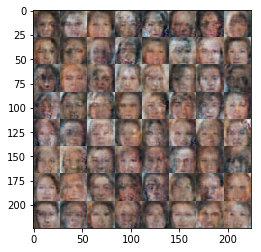

Epoch 1/4... Discriminator Loss: 1.9675... Generator Loss: 0.1863
Epoch 1/4... Discriminator Loss: 2.6833... Generator Loss: 0.0886
Epoch 1/4... Discriminator Loss: 1.0325... Generator Loss: 0.8154
Epoch 1/4... Discriminator Loss: 3.2007... Generator Loss: 0.0428
Epoch 1/4... Discriminator Loss: 2.3162... Generator Loss: 0.1426
Epoch 1/4... Discriminator Loss: 1.4677... Generator Loss: 1.7121
Epoch 1/4... Discriminator Loss: 3.0379... Generator Loss: 0.0654
Epoch 1/4... Discriminator Loss: 1.1988... Generator Loss: 0.9532
Epoch 1/4... Discriminator Loss: 2.0466... Generator Loss: 0.1954
Epoch 1/4... Discriminator Loss: 1.8124... Generator Loss: 0.2877


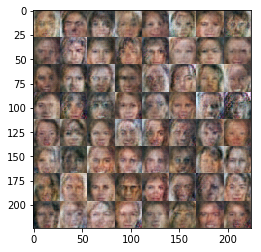

Epoch 1/4... Discriminator Loss: 2.3079... Generator Loss: 0.1757
Epoch 1/4... Discriminator Loss: 1.9569... Generator Loss: 0.1678
Epoch 1/4... Discriminator Loss: 1.4294... Generator Loss: 1.3092
Epoch 1/4... Discriminator Loss: 3.8589... Generator Loss: 0.0381
Epoch 1/4... Discriminator Loss: 1.3939... Generator Loss: 0.6108
Epoch 1/4... Discriminator Loss: 1.3868... Generator Loss: 1.1649
Epoch 1/4... Discriminator Loss: 1.6070... Generator Loss: 1.0912
Epoch 1/4... Discriminator Loss: 1.5295... Generator Loss: 0.3806
Epoch 1/4... Discriminator Loss: 2.7853... Generator Loss: 0.0757
Epoch 1/4... Discriminator Loss: 1.5740... Generator Loss: 0.3332


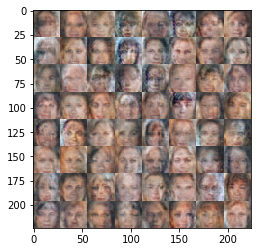

Epoch 1/4... Discriminator Loss: 1.3706... Generator Loss: 0.7512
Epoch 1/4... Discriminator Loss: 1.7328... Generator Loss: 0.3170
Epoch 1/4... Discriminator Loss: 1.2936... Generator Loss: 0.5115
Epoch 1/4... Discriminator Loss: 1.9166... Generator Loss: 0.2076
Epoch 1/4... Discriminator Loss: 1.3938... Generator Loss: 0.9280
Epoch 1/4... Discriminator Loss: 2.6045... Generator Loss: 0.1031
Epoch 1/4... Discriminator Loss: 1.1333... Generator Loss: 2.4297
Epoch 1/4... Discriminator Loss: 1.3932... Generator Loss: 1.2900
Epoch 1/4... Discriminator Loss: 1.9172... Generator Loss: 0.3808
Epoch 1/4... Discriminator Loss: 1.2911... Generator Loss: 0.4359


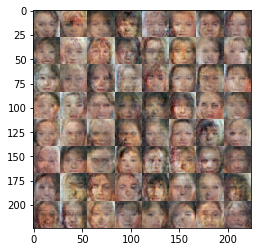

Epoch 1/4... Discriminator Loss: 1.7389... Generator Loss: 0.3411
Epoch 1/4... Discriminator Loss: 1.4622... Generator Loss: 1.7761
Epoch 1/4... Discriminator Loss: 3.9819... Generator Loss: 0.0246
Epoch 1/4... Discriminator Loss: 1.6185... Generator Loss: 0.4715
Epoch 1/4... Discriminator Loss: 1.6031... Generator Loss: 0.6846
Epoch 1/4... Discriminator Loss: 3.3564... Generator Loss: 3.8833
Epoch 1/4... Discriminator Loss: 3.4691... Generator Loss: 0.0351
Epoch 1/4... Discriminator Loss: 1.8310... Generator Loss: 0.3585
Epoch 1/4... Discriminator Loss: 1.4972... Generator Loss: 0.3104
Epoch 1/4... Discriminator Loss: 2.5292... Generator Loss: 0.1186


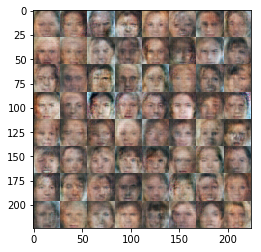

Epoch 1/4... Discriminator Loss: 2.3291... Generator Loss: 0.1443
Epoch 1/4... Discriminator Loss: 1.2584... Generator Loss: 0.6531
Epoch 1/4... Discriminator Loss: 2.1761... Generator Loss: 0.1389
Epoch 1/4... Discriminator Loss: 2.2374... Generator Loss: 0.1645
Epoch 1/4... Discriminator Loss: 1.5063... Generator Loss: 1.2659
Epoch 1/4... Discriminator Loss: 3.1262... Generator Loss: 1.1589
Epoch 1/4... Discriminator Loss: 2.1541... Generator Loss: 0.1796
Epoch 1/4... Discriminator Loss: 2.3676... Generator Loss: 0.1111
Epoch 1/4... Discriminator Loss: 1.6077... Generator Loss: 0.4408
Epoch 1/4... Discriminator Loss: 2.0574... Generator Loss: 0.1967


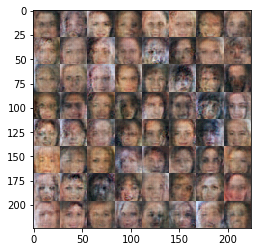

Epoch 1/4... Discriminator Loss: 1.8792... Generator Loss: 0.2392
Epoch 1/4... Discriminator Loss: 1.6433... Generator Loss: 0.4138
Epoch 1/4... Discriminator Loss: 2.0974... Generator Loss: 0.2690
Epoch 1/4... Discriminator Loss: 2.0057... Generator Loss: 0.1803
Epoch 1/4... Discriminator Loss: 1.3747... Generator Loss: 1.0092
Epoch 1/4... Discriminator Loss: 1.9734... Generator Loss: 0.4462
Epoch 1/4... Discriminator Loss: 2.3971... Generator Loss: 0.1198
Epoch 1/4... Discriminator Loss: 1.8937... Generator Loss: 0.2230
Epoch 1/4... Discriminator Loss: 1.6848... Generator Loss: 0.4105
Epoch 1/4... Discriminator Loss: 1.9494... Generator Loss: 0.2116


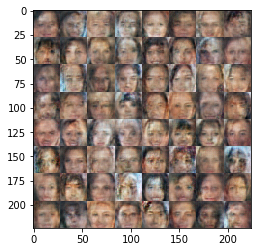

Epoch 1/4... Discriminator Loss: 1.4235... Generator Loss: 0.3992
Epoch 1/4... Discriminator Loss: 1.2005... Generator Loss: 0.7287
Epoch 1/4... Discriminator Loss: 1.6585... Generator Loss: 0.3347
Epoch 1/4... Discriminator Loss: 2.2745... Generator Loss: 0.2211
Epoch 1/4... Discriminator Loss: 2.1389... Generator Loss: 0.1464
Epoch 1/4... Discriminator Loss: 1.8928... Generator Loss: 0.2096
Epoch 1/4... Discriminator Loss: 1.9465... Generator Loss: 1.4255
Epoch 1/4... Discriminator Loss: 3.2094... Generator Loss: 0.0579
Epoch 1/4... Discriminator Loss: 1.5791... Generator Loss: 0.3445
Epoch 1/4... Discriminator Loss: 1.3110... Generator Loss: 1.0043


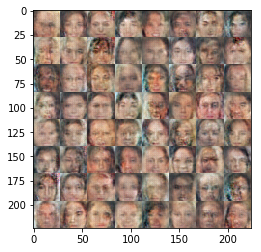

Epoch 1/4... Discriminator Loss: 2.0830... Generator Loss: 0.1575
Epoch 1/4... Discriminator Loss: 1.8751... Generator Loss: 0.5391
Epoch 1/4... Discriminator Loss: 3.4905... Generator Loss: 0.0541
Epoch 1/4... Discriminator Loss: 2.7800... Generator Loss: 0.1005
Epoch 1/4... Discriminator Loss: 2.7912... Generator Loss: 0.0770
Epoch 1/4... Discriminator Loss: 1.9557... Generator Loss: 0.7971
Epoch 1/4... Discriminator Loss: 1.5092... Generator Loss: 0.8191
Epoch 1/4... Discriminator Loss: 1.6472... Generator Loss: 1.3318
Epoch 1/4... Discriminator Loss: 1.7832... Generator Loss: 0.3104
Epoch 1/4... Discriminator Loss: 2.5102... Generator Loss: 1.1103


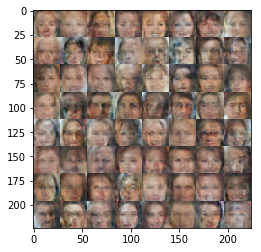

Epoch 1/4... Discriminator Loss: 1.1653... Generator Loss: 0.9610
Epoch 1/4... Discriminator Loss: 1.6651... Generator Loss: 0.2755
Epoch 1/4... Discriminator Loss: 2.5139... Generator Loss: 0.1142
Epoch 1/4... Discriminator Loss: 1.4455... Generator Loss: 1.1553
Epoch 1/4... Discriminator Loss: 1.4207... Generator Loss: 0.4780
Epoch 1/4... Discriminator Loss: 2.5663... Generator Loss: 0.0978
Epoch 1/4... Discriminator Loss: 1.8850... Generator Loss: 0.2129
Epoch 1/4... Discriminator Loss: 1.9185... Generator Loss: 0.2395
Epoch 1/4... Discriminator Loss: 1.6209... Generator Loss: 0.4011
Epoch 1/4... Discriminator Loss: 2.1086... Generator Loss: 0.2293


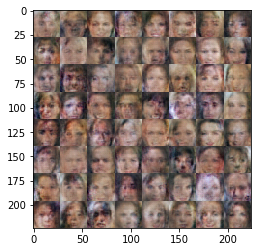

Epoch 1/4... Discriminator Loss: 1.5885... Generator Loss: 0.4709
Epoch 1/4... Discriminator Loss: 2.2769... Generator Loss: 0.1233
Epoch 1/4... Discriminator Loss: 1.8732... Generator Loss: 0.2910
Epoch 1/4... Discriminator Loss: 2.7941... Generator Loss: 0.0676
Epoch 1/4... Discriminator Loss: 1.6641... Generator Loss: 0.3978
Epoch 1/4... Discriminator Loss: 2.1292... Generator Loss: 0.1610
Epoch 1/4... Discriminator Loss: 2.7815... Generator Loss: 0.5331
Epoch 1/4... Discriminator Loss: 1.5248... Generator Loss: 1.4064
Epoch 1/4... Discriminator Loss: 1.3240... Generator Loss: 0.7802
Epoch 1/4... Discriminator Loss: 2.2032... Generator Loss: 0.3742


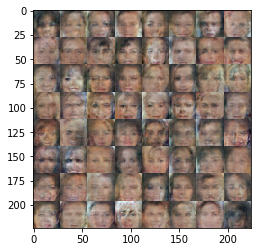

Epoch 1/4... Discriminator Loss: 2.1852... Generator Loss: 0.8894
Epoch 1/4... Discriminator Loss: 1.9254... Generator Loss: 0.2906
Epoch 1/4... Discriminator Loss: 2.0430... Generator Loss: 0.9094
Epoch 1/4... Discriminator Loss: 1.5274... Generator Loss: 0.3469
Epoch 1/4... Discriminator Loss: 2.1145... Generator Loss: 0.1510
Epoch 1/4... Discriminator Loss: 1.2604... Generator Loss: 0.5077
Epoch 1/4... Discriminator Loss: 2.2467... Generator Loss: 0.1313
Epoch 1/4... Discriminator Loss: 1.4990... Generator Loss: 0.4868
Epoch 1/4... Discriminator Loss: 1.5153... Generator Loss: 0.5856
Epoch 1/4... Discriminator Loss: 1.8725... Generator Loss: 0.3190


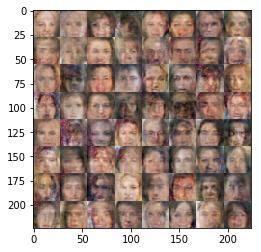

Epoch 1/4... Discriminator Loss: 1.6901... Generator Loss: 0.6079
Epoch 1/4... Discriminator Loss: 1.8105... Generator Loss: 0.6518
Epoch 1/4... Discriminator Loss: 1.2945... Generator Loss: 0.9892
Epoch 1/4... Discriminator Loss: 1.9703... Generator Loss: 0.2907
Epoch 1/4... Discriminator Loss: 1.8166... Generator Loss: 0.2493
Epoch 1/4... Discriminator Loss: 2.0469... Generator Loss: 0.1823
Epoch 1/4... Discriminator Loss: 2.7927... Generator Loss: 0.8697
Epoch 1/4... Discriminator Loss: 1.2198... Generator Loss: 0.7439
Epoch 1/4... Discriminator Loss: 2.1487... Generator Loss: 0.1568
Epoch 1/4... Discriminator Loss: 1.6497... Generator Loss: 0.6791


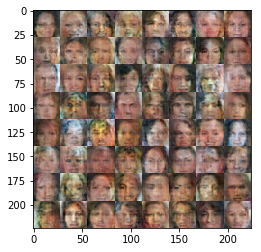

Epoch 1/4... Discriminator Loss: 2.3917... Generator Loss: 0.1200
Epoch 1/4... Discriminator Loss: 1.6096... Generator Loss: 0.3770
Epoch 1/4... Discriminator Loss: 2.0830... Generator Loss: 0.1527
Epoch 1/4... Discriminator Loss: 1.3008... Generator Loss: 0.5045
Epoch 1/4... Discriminator Loss: 1.6160... Generator Loss: 1.0210
Epoch 1/4... Discriminator Loss: 1.9358... Generator Loss: 0.1817
Epoch 2/4... Discriminator Loss: 1.6816... Generator Loss: 0.4790
Epoch 2/4... Discriminator Loss: 2.5586... Generator Loss: 0.1319
Epoch 2/4... Discriminator Loss: 3.0435... Generator Loss: 0.4084
Epoch 2/4... Discriminator Loss: 3.0550... Generator Loss: 0.0536
Epoch 2/4... Discriminator Loss: 1.3560... Generator Loss: 0.4663
Epoch 2/4... Discriminator Loss: 2.6607... Generator Loss: 0.0857
Epoch 2/4... Discriminator Loss: 1.8698... Generator Loss: 0.2026
Epoch 2/4... Discriminator Loss: 2.1557... Generator Loss: 0.1464
Epoch 2/4... Discriminator Loss: 2.4651... Generator Loss: 0.1349
Epoch 2/4.

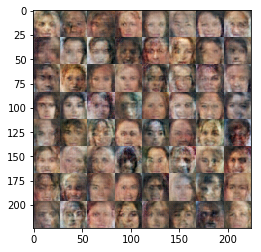

Epoch 2/4... Discriminator Loss: 2.2449... Generator Loss: 0.6323
Epoch 2/4... Discriminator Loss: 2.0278... Generator Loss: 0.2412
Epoch 2/4... Discriminator Loss: 1.8092... Generator Loss: 0.4335
Epoch 2/4... Discriminator Loss: 1.9483... Generator Loss: 0.6907
Epoch 2/4... Discriminator Loss: 1.3110... Generator Loss: 0.7149
Epoch 2/4... Discriminator Loss: 2.2187... Generator Loss: 0.1648
Epoch 2/4... Discriminator Loss: 1.5523... Generator Loss: 0.3881
Epoch 2/4... Discriminator Loss: 1.9428... Generator Loss: 0.2323
Epoch 2/4... Discriminator Loss: 2.0626... Generator Loss: 0.1492
Epoch 2/4... Discriminator Loss: 2.4228... Generator Loss: 0.1048


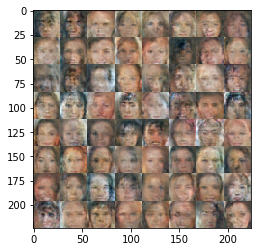

Epoch 2/4... Discriminator Loss: 2.7550... Generator Loss: 0.0829
Epoch 2/4... Discriminator Loss: 2.8448... Generator Loss: 0.0742
Epoch 2/4... Discriminator Loss: 2.1571... Generator Loss: 0.1748
Epoch 2/4... Discriminator Loss: 2.6401... Generator Loss: 0.0810
Epoch 2/4... Discriminator Loss: 1.6634... Generator Loss: 0.2949
Epoch 2/4... Discriminator Loss: 3.0365... Generator Loss: 0.0748
Epoch 2/4... Discriminator Loss: 1.5009... Generator Loss: 0.4420
Epoch 2/4... Discriminator Loss: 1.5882... Generator Loss: 0.7017
Epoch 2/4... Discriminator Loss: 2.0589... Generator Loss: 0.6646
Epoch 2/4... Discriminator Loss: 1.4603... Generator Loss: 0.3558


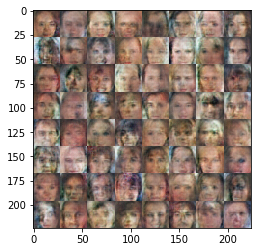

Epoch 2/4... Discriminator Loss: 2.0631... Generator Loss: 1.0298
Epoch 2/4... Discriminator Loss: 1.7517... Generator Loss: 0.4653
Epoch 2/4... Discriminator Loss: 1.5395... Generator Loss: 0.3863
Epoch 2/4... Discriminator Loss: 2.6886... Generator Loss: 0.0739
Epoch 2/4... Discriminator Loss: 1.9575... Generator Loss: 0.2414
Epoch 2/4... Discriminator Loss: 2.0021... Generator Loss: 0.2245
Epoch 2/4... Discriminator Loss: 1.8123... Generator Loss: 0.2164
Epoch 2/4... Discriminator Loss: 1.5836... Generator Loss: 0.5812
Epoch 2/4... Discriminator Loss: 1.6941... Generator Loss: 0.2865
Epoch 2/4... Discriminator Loss: 4.2120... Generator Loss: 0.0369


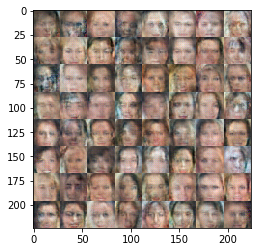

Epoch 2/4... Discriminator Loss: 6.8833... Generator Loss: 2.1157
Epoch 2/4... Discriminator Loss: 2.7274... Generator Loss: 1.1482
Epoch 2/4... Discriminator Loss: 2.9973... Generator Loss: 0.4908
Epoch 2/4... Discriminator Loss: 2.3680... Generator Loss: 0.1718
Epoch 2/4... Discriminator Loss: 1.5876... Generator Loss: 0.8002
Epoch 2/4... Discriminator Loss: 1.7807... Generator Loss: 0.2584
Epoch 2/4... Discriminator Loss: 2.1668... Generator Loss: 0.1443
Epoch 2/4... Discriminator Loss: 1.4549... Generator Loss: 0.5255
Epoch 2/4... Discriminator Loss: 1.8745... Generator Loss: 0.2385
Epoch 2/4... Discriminator Loss: 2.1550... Generator Loss: 0.1546


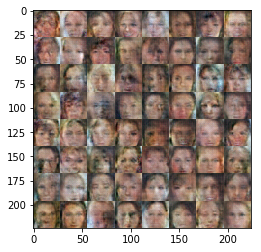

Epoch 2/4... Discriminator Loss: 2.1590... Generator Loss: 0.1526
Epoch 2/4... Discriminator Loss: 1.4787... Generator Loss: 0.5743
Epoch 2/4... Discriminator Loss: 1.7718... Generator Loss: 0.2745
Epoch 2/4... Discriminator Loss: 2.1847... Generator Loss: 0.1491
Epoch 2/4... Discriminator Loss: 1.8411... Generator Loss: 0.2861
Epoch 2/4... Discriminator Loss: 1.5829... Generator Loss: 0.4039
Epoch 2/4... Discriminator Loss: 1.8855... Generator Loss: 0.2114
Epoch 2/4... Discriminator Loss: 1.5191... Generator Loss: 0.3799
Epoch 2/4... Discriminator Loss: 2.4956... Generator Loss: 0.1204
Epoch 2/4... Discriminator Loss: 1.3641... Generator Loss: 0.4458


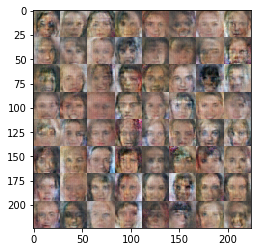

Epoch 2/4... Discriminator Loss: 2.1303... Generator Loss: 0.1626
Epoch 2/4... Discriminator Loss: 2.0042... Generator Loss: 0.1579
Epoch 2/4... Discriminator Loss: 1.5546... Generator Loss: 0.5426
Epoch 2/4... Discriminator Loss: 1.6213... Generator Loss: 0.6789
Epoch 2/4... Discriminator Loss: 1.5231... Generator Loss: 0.4892
Epoch 2/4... Discriminator Loss: 2.0930... Generator Loss: 0.1670
Epoch 2/4... Discriminator Loss: 1.6451... Generator Loss: 0.5059
Epoch 2/4... Discriminator Loss: 2.2314... Generator Loss: 0.1587
Epoch 2/4... Discriminator Loss: 1.6426... Generator Loss: 0.5411
Epoch 2/4... Discriminator Loss: 2.1336... Generator Loss: 0.1393


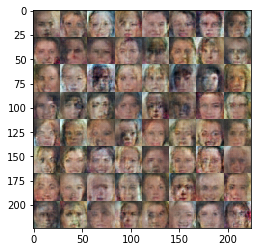

Epoch 2/4... Discriminator Loss: 2.7696... Generator Loss: 0.0900
Epoch 2/4... Discriminator Loss: 1.7413... Generator Loss: 0.4397
Epoch 2/4... Discriminator Loss: 1.4678... Generator Loss: 0.5149
Epoch 2/4... Discriminator Loss: 1.8936... Generator Loss: 0.2926
Epoch 2/4... Discriminator Loss: 1.6687... Generator Loss: 0.6308
Epoch 2/4... Discriminator Loss: 2.4655... Generator Loss: 0.2182
Epoch 2/4... Discriminator Loss: 2.5674... Generator Loss: 0.0890
Epoch 2/4... Discriminator Loss: 1.8240... Generator Loss: 0.2607
Epoch 2/4... Discriminator Loss: 2.2255... Generator Loss: 0.1514
Epoch 2/4... Discriminator Loss: 1.7631... Generator Loss: 0.6168


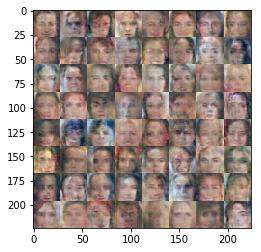

Epoch 2/4... Discriminator Loss: 2.4637... Generator Loss: 0.1015
Epoch 2/4... Discriminator Loss: 1.5809... Generator Loss: 0.3396
Epoch 2/4... Discriminator Loss: 1.6585... Generator Loss: 0.4290
Epoch 2/4... Discriminator Loss: 2.3681... Generator Loss: 0.1418
Epoch 2/4... Discriminator Loss: 2.1952... Generator Loss: 0.1731
Epoch 2/4... Discriminator Loss: 1.3760... Generator Loss: 0.8924
Epoch 2/4... Discriminator Loss: 1.8758... Generator Loss: 0.2221
Epoch 2/4... Discriminator Loss: 2.1955... Generator Loss: 0.1657
Epoch 2/4... Discriminator Loss: 1.7450... Generator Loss: 0.2557
Epoch 2/4... Discriminator Loss: 1.9379... Generator Loss: 0.2429


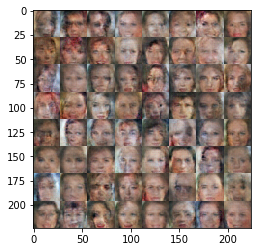

Epoch 2/4... Discriminator Loss: 1.5218... Generator Loss: 0.3609
Epoch 2/4... Discriminator Loss: 1.3192... Generator Loss: 0.8425
Epoch 2/4... Discriminator Loss: 2.3862... Generator Loss: 0.1269
Epoch 2/4... Discriminator Loss: 1.9021... Generator Loss: 0.1837
Epoch 2/4... Discriminator Loss: 1.9124... Generator Loss: 0.8074
Epoch 2/4... Discriminator Loss: 2.1771... Generator Loss: 0.1496
Epoch 2/4... Discriminator Loss: 2.0075... Generator Loss: 0.1806
Epoch 2/4... Discriminator Loss: 2.3393... Generator Loss: 0.1285
Epoch 2/4... Discriminator Loss: 1.4397... Generator Loss: 0.3517
Epoch 2/4... Discriminator Loss: 2.0807... Generator Loss: 0.1606


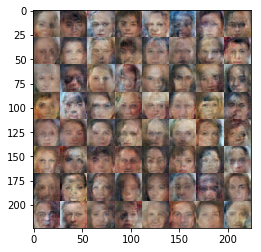

Epoch 2/4... Discriminator Loss: 1.3947... Generator Loss: 0.6760
Epoch 2/4... Discriminator Loss: 2.5199... Generator Loss: 0.0948
Epoch 2/4... Discriminator Loss: 2.0167... Generator Loss: 0.1793
Epoch 2/4... Discriminator Loss: 1.6268... Generator Loss: 0.5173
Epoch 2/4... Discriminator Loss: 2.2281... Generator Loss: 0.1878
Epoch 2/4... Discriminator Loss: 2.4276... Generator Loss: 0.0969
Epoch 2/4... Discriminator Loss: 1.4732... Generator Loss: 0.5465
Epoch 2/4... Discriminator Loss: 1.5040... Generator Loss: 0.4887
Epoch 2/4... Discriminator Loss: 1.6060... Generator Loss: 0.4620
Epoch 2/4... Discriminator Loss: 1.4040... Generator Loss: 0.3923


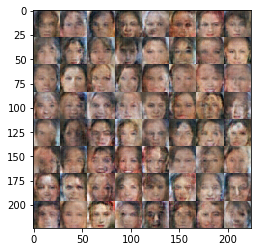

Epoch 2/4... Discriminator Loss: 1.6795... Generator Loss: 0.3620
Epoch 2/4... Discriminator Loss: 1.2815... Generator Loss: 0.5438
Epoch 2/4... Discriminator Loss: 1.7339... Generator Loss: 0.3161
Epoch 2/4... Discriminator Loss: 2.2973... Generator Loss: 0.1229
Epoch 2/4... Discriminator Loss: 1.6697... Generator Loss: 0.2595
Epoch 2/4... Discriminator Loss: 1.7755... Generator Loss: 0.2681
Epoch 2/4... Discriminator Loss: 2.0615... Generator Loss: 0.1624
Epoch 2/4... Discriminator Loss: 2.4875... Generator Loss: 0.0944
Epoch 2/4... Discriminator Loss: 2.9439... Generator Loss: 0.0930
Epoch 2/4... Discriminator Loss: 1.7311... Generator Loss: 0.2172


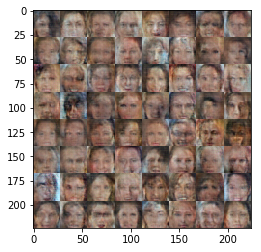

Epoch 2/4... Discriminator Loss: 2.1382... Generator Loss: 0.1389
Epoch 2/4... Discriminator Loss: 1.7760... Generator Loss: 0.2645
Epoch 2/4... Discriminator Loss: 1.2721... Generator Loss: 0.8558
Epoch 2/4... Discriminator Loss: 1.3593... Generator Loss: 0.6173
Epoch 2/4... Discriminator Loss: 1.4977... Generator Loss: 0.3497
Epoch 2/4... Discriminator Loss: 1.7608... Generator Loss: 0.2469
Epoch 2/4... Discriminator Loss: 1.9257... Generator Loss: 0.1988
Epoch 2/4... Discriminator Loss: 1.6101... Generator Loss: 0.6663
Epoch 2/4... Discriminator Loss: 1.2082... Generator Loss: 0.5917
Epoch 2/4... Discriminator Loss: 2.0905... Generator Loss: 0.3030


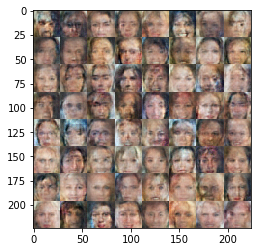

Epoch 2/4... Discriminator Loss: 2.1066... Generator Loss: 0.1884
Epoch 2/4... Discriminator Loss: 1.6067... Generator Loss: 0.3075
Epoch 2/4... Discriminator Loss: 1.1449... Generator Loss: 0.6981
Epoch 2/4... Discriminator Loss: 1.6409... Generator Loss: 0.3203
Epoch 2/4... Discriminator Loss: 1.8074... Generator Loss: 1.1227
Epoch 2/4... Discriminator Loss: 2.1449... Generator Loss: 0.7898
Epoch 2/4... Discriminator Loss: 2.6312... Generator Loss: 0.0787
Epoch 2/4... Discriminator Loss: 1.5416... Generator Loss: 0.4802
Epoch 2/4... Discriminator Loss: 1.5076... Generator Loss: 0.4413
Epoch 2/4... Discriminator Loss: 1.4489... Generator Loss: 0.4944


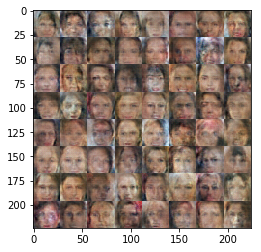

Epoch 2/4... Discriminator Loss: 2.2247... Generator Loss: 0.1618
Epoch 2/4... Discriminator Loss: 1.6913... Generator Loss: 0.9238
Epoch 2/4... Discriminator Loss: 2.4791... Generator Loss: 0.1003
Epoch 2/4... Discriminator Loss: 1.6072... Generator Loss: 0.3920
Epoch 2/4... Discriminator Loss: 1.6395... Generator Loss: 0.2798
Epoch 2/4... Discriminator Loss: 1.9230... Generator Loss: 0.4186
Epoch 2/4... Discriminator Loss: 2.1313... Generator Loss: 0.1617
Epoch 2/4... Discriminator Loss: 2.1775... Generator Loss: 0.1833
Epoch 2/4... Discriminator Loss: 2.1260... Generator Loss: 0.1526
Epoch 2/4... Discriminator Loss: 1.4611... Generator Loss: 0.4126


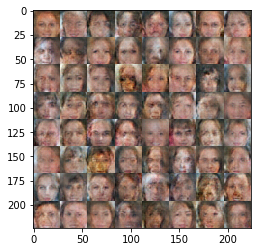

Epoch 2/4... Discriminator Loss: 1.1821... Generator Loss: 0.9880
Epoch 2/4... Discriminator Loss: 1.3940... Generator Loss: 0.5553
Epoch 2/4... Discriminator Loss: 1.4685... Generator Loss: 0.5201
Epoch 2/4... Discriminator Loss: 2.1860... Generator Loss: 0.2070
Epoch 2/4... Discriminator Loss: 1.7801... Generator Loss: 1.4397
Epoch 2/4... Discriminator Loss: 1.5725... Generator Loss: 0.3059
Epoch 2/4... Discriminator Loss: 1.9132... Generator Loss: 0.2142
Epoch 2/4... Discriminator Loss: 2.2602... Generator Loss: 0.1488
Epoch 2/4... Discriminator Loss: 1.6071... Generator Loss: 0.3533
Epoch 2/4... Discriminator Loss: 1.4907... Generator Loss: 0.7183


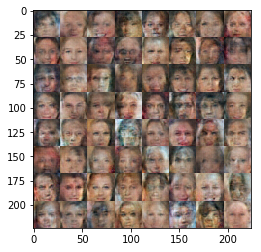

Epoch 2/4... Discriminator Loss: 1.5532... Generator Loss: 0.4381
Epoch 2/4... Discriminator Loss: 2.3595... Generator Loss: 0.1110
Epoch 2/4... Discriminator Loss: 1.6140... Generator Loss: 0.6988
Epoch 2/4... Discriminator Loss: 2.2235... Generator Loss: 0.1520
Epoch 2/4... Discriminator Loss: 1.8949... Generator Loss: 0.9583
Epoch 2/4... Discriminator Loss: 1.5829... Generator Loss: 0.3492
Epoch 2/4... Discriminator Loss: 1.6008... Generator Loss: 0.3010
Epoch 2/4... Discriminator Loss: 1.5862... Generator Loss: 0.3132
Epoch 2/4... Discriminator Loss: 2.2387... Generator Loss: 0.1569
Epoch 2/4... Discriminator Loss: 1.7796... Generator Loss: 0.2380


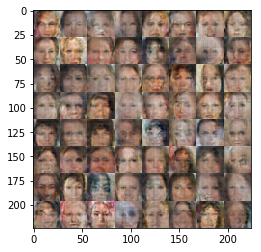

Epoch 2/4... Discriminator Loss: 2.0354... Generator Loss: 0.1817
Epoch 2/4... Discriminator Loss: 1.6163... Generator Loss: 0.5807
Epoch 2/4... Discriminator Loss: 2.2529... Generator Loss: 0.1211
Epoch 2/4... Discriminator Loss: 2.2155... Generator Loss: 0.1738
Epoch 2/4... Discriminator Loss: 1.3332... Generator Loss: 0.8772
Epoch 2/4... Discriminator Loss: 2.5280... Generator Loss: 0.0931
Epoch 2/4... Discriminator Loss: 1.7419... Generator Loss: 0.4572
Epoch 2/4... Discriminator Loss: 1.7964... Generator Loss: 0.2832
Epoch 2/4... Discriminator Loss: 1.4156... Generator Loss: 0.3921
Epoch 2/4... Discriminator Loss: 1.6255... Generator Loss: 1.0542


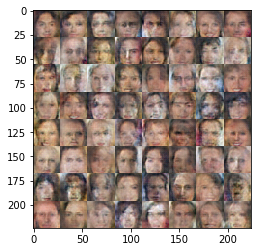

Epoch 2/4... Discriminator Loss: 1.4645... Generator Loss: 0.5747
Epoch 2/4... Discriminator Loss: 1.3221... Generator Loss: 0.5285
Epoch 2/4... Discriminator Loss: 1.5966... Generator Loss: 0.3156
Epoch 2/4... Discriminator Loss: 2.3215... Generator Loss: 0.1355
Epoch 2/4... Discriminator Loss: 2.1975... Generator Loss: 0.1480
Epoch 2/4... Discriminator Loss: 1.3326... Generator Loss: 0.5696
Epoch 2/4... Discriminator Loss: 1.6628... Generator Loss: 0.4230
Epoch 2/4... Discriminator Loss: 2.5004... Generator Loss: 0.1030
Epoch 2/4... Discriminator Loss: 1.5226... Generator Loss: 0.4755
Epoch 2/4... Discriminator Loss: 1.6735... Generator Loss: 0.2656


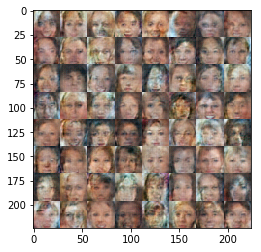

Epoch 2/4... Discriminator Loss: 2.0543... Generator Loss: 0.2018
Epoch 2/4... Discriminator Loss: 2.4784... Generator Loss: 0.6737
Epoch 2/4... Discriminator Loss: 2.2071... Generator Loss: 0.1606
Epoch 2/4... Discriminator Loss: 1.3250... Generator Loss: 0.7134
Epoch 2/4... Discriminator Loss: 1.2746... Generator Loss: 0.5341
Epoch 2/4... Discriminator Loss: 2.1088... Generator Loss: 0.1525
Epoch 2/4... Discriminator Loss: 1.2717... Generator Loss: 0.5395
Epoch 2/4... Discriminator Loss: 2.0228... Generator Loss: 0.1639
Epoch 2/4... Discriminator Loss: 2.0277... Generator Loss: 0.1724
Epoch 2/4... Discriminator Loss: 1.7895... Generator Loss: 0.2576


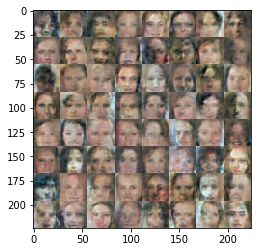

Epoch 2/4... Discriminator Loss: 1.6692... Generator Loss: 0.2879
Epoch 2/4... Discriminator Loss: 1.7834... Generator Loss: 0.3208
Epoch 2/4... Discriminator Loss: 1.4867... Generator Loss: 1.1535
Epoch 2/4... Discriminator Loss: 1.7745... Generator Loss: 0.2635
Epoch 2/4... Discriminator Loss: 1.3315... Generator Loss: 1.0798
Epoch 2/4... Discriminator Loss: 2.4377... Generator Loss: 0.1278
Epoch 2/4... Discriminator Loss: 1.6884... Generator Loss: 0.4082
Epoch 2/4... Discriminator Loss: 1.3984... Generator Loss: 0.3762
Epoch 2/4... Discriminator Loss: 1.6577... Generator Loss: 0.2929
Epoch 2/4... Discriminator Loss: 2.0565... Generator Loss: 0.1655


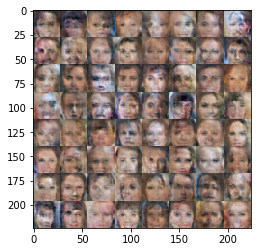

Epoch 2/4... Discriminator Loss: 1.6455... Generator Loss: 0.3196
Epoch 2/4... Discriminator Loss: 1.6147... Generator Loss: 0.3569
Epoch 2/4... Discriminator Loss: 1.5970... Generator Loss: 0.6106
Epoch 2/4... Discriminator Loss: 1.4494... Generator Loss: 1.0200
Epoch 2/4... Discriminator Loss: 1.4103... Generator Loss: 1.3776
Epoch 2/4... Discriminator Loss: 2.0566... Generator Loss: 0.2098
Epoch 2/4... Discriminator Loss: 1.2188... Generator Loss: 0.9036
Epoch 2/4... Discriminator Loss: 1.6219... Generator Loss: 1.4828
Epoch 2/4... Discriminator Loss: 2.1112... Generator Loss: 0.1534
Epoch 2/4... Discriminator Loss: 1.3467... Generator Loss: 0.7414


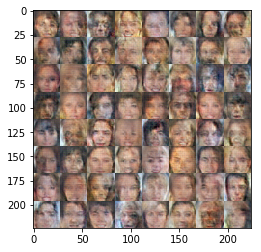

Epoch 2/4... Discriminator Loss: 1.5998... Generator Loss: 0.4537
Epoch 2/4... Discriminator Loss: 2.6243... Generator Loss: 0.1087
Epoch 2/4... Discriminator Loss: 1.8606... Generator Loss: 0.2075
Epoch 2/4... Discriminator Loss: 2.2605... Generator Loss: 0.1346
Epoch 2/4... Discriminator Loss: 2.2241... Generator Loss: 0.1417
Epoch 2/4... Discriminator Loss: 1.4155... Generator Loss: 0.9228
Epoch 2/4... Discriminator Loss: 1.6997... Generator Loss: 1.0088
Epoch 2/4... Discriminator Loss: 2.5086... Generator Loss: 0.0913
Epoch 2/4... Discriminator Loss: 1.9141... Generator Loss: 0.2571
Epoch 2/4... Discriminator Loss: 1.4366... Generator Loss: 0.8778


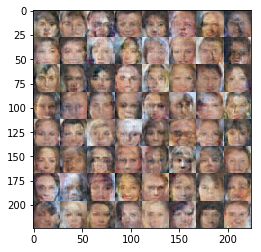

Epoch 2/4... Discriminator Loss: 1.7912... Generator Loss: 0.2412
Epoch 2/4... Discriminator Loss: 1.4939... Generator Loss: 0.5130
Epoch 2/4... Discriminator Loss: 1.5850... Generator Loss: 0.3412
Epoch 2/4... Discriminator Loss: 2.2029... Generator Loss: 0.1357
Epoch 2/4... Discriminator Loss: 1.2749... Generator Loss: 0.6624
Epoch 2/4... Discriminator Loss: 2.1212... Generator Loss: 0.1458
Epoch 2/4... Discriminator Loss: 2.3345... Generator Loss: 0.1377
Epoch 2/4... Discriminator Loss: 1.5280... Generator Loss: 0.3512
Epoch 2/4... Discriminator Loss: 1.9121... Generator Loss: 0.2750
Epoch 2/4... Discriminator Loss: 1.4012... Generator Loss: 0.4558


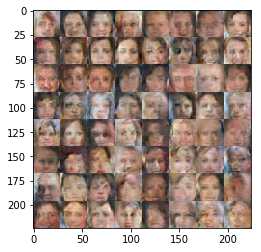

Epoch 2/4... Discriminator Loss: 1.9991... Generator Loss: 0.1776
Epoch 2/4... Discriminator Loss: 1.7882... Generator Loss: 0.2756
Epoch 2/4... Discriminator Loss: 1.4627... Generator Loss: 0.4411
Epoch 2/4... Discriminator Loss: 1.9012... Generator Loss: 0.1902
Epoch 2/4... Discriminator Loss: 1.6652... Generator Loss: 0.2846
Epoch 2/4... Discriminator Loss: 1.7462... Generator Loss: 0.4034
Epoch 2/4... Discriminator Loss: 1.3696... Generator Loss: 0.4094
Epoch 2/4... Discriminator Loss: 1.7698... Generator Loss: 0.2485
Epoch 2/4... Discriminator Loss: 1.4017... Generator Loss: 0.6452
Epoch 2/4... Discriminator Loss: 1.7418... Generator Loss: 0.2254


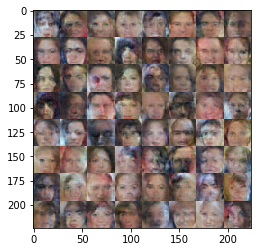

Epoch 2/4... Discriminator Loss: 2.0084... Generator Loss: 0.1779
Epoch 2/4... Discriminator Loss: 1.6418... Generator Loss: 0.3104
Epoch 2/4... Discriminator Loss: 2.7207... Generator Loss: 0.0877
Epoch 2/4... Discriminator Loss: 2.0859... Generator Loss: 0.2432
Epoch 2/4... Discriminator Loss: 2.2152... Generator Loss: 0.1619
Epoch 2/4... Discriminator Loss: 2.1238... Generator Loss: 0.1686
Epoch 2/4... Discriminator Loss: 1.6071... Generator Loss: 0.2606
Epoch 2/4... Discriminator Loss: 2.4454... Generator Loss: 0.1202
Epoch 2/4... Discriminator Loss: 2.0403... Generator Loss: 0.1661
Epoch 2/4... Discriminator Loss: 1.3709... Generator Loss: 0.6472


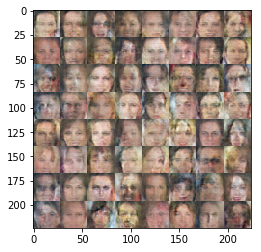

Epoch 2/4... Discriminator Loss: 1.3159... Generator Loss: 0.6651
Epoch 2/4... Discriminator Loss: 1.5978... Generator Loss: 0.6652
Epoch 2/4... Discriminator Loss: 1.3159... Generator Loss: 0.6541
Epoch 2/4... Discriminator Loss: 1.5925... Generator Loss: 0.6236
Epoch 2/4... Discriminator Loss: 1.7495... Generator Loss: 0.2681
Epoch 2/4... Discriminator Loss: 1.7435... Generator Loss: 0.6023
Epoch 2/4... Discriminator Loss: 1.7824... Generator Loss: 0.9250
Epoch 2/4... Discriminator Loss: 2.0773... Generator Loss: 0.1779
Epoch 2/4... Discriminator Loss: 1.7620... Generator Loss: 0.3325
Epoch 2/4... Discriminator Loss: 1.9914... Generator Loss: 0.2201


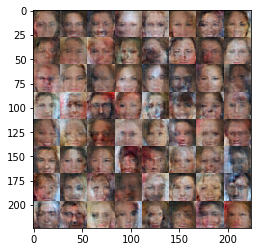

Epoch 2/4... Discriminator Loss: 1.4846... Generator Loss: 0.7702
Epoch 2/4... Discriminator Loss: 1.6985... Generator Loss: 0.4226
Epoch 2/4... Discriminator Loss: 2.0305... Generator Loss: 0.4366
Epoch 2/4... Discriminator Loss: 1.6271... Generator Loss: 0.4356
Epoch 2/4... Discriminator Loss: 1.7630... Generator Loss: 0.3364
Epoch 2/4... Discriminator Loss: 1.6515... Generator Loss: 0.9551
Epoch 2/4... Discriminator Loss: 2.1617... Generator Loss: 0.1353
Epoch 2/4... Discriminator Loss: 1.7520... Generator Loss: 0.2793
Epoch 2/4... Discriminator Loss: 1.4936... Generator Loss: 0.3600
Epoch 2/4... Discriminator Loss: 1.3492... Generator Loss: 0.6749


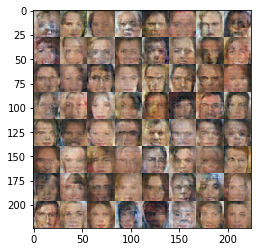

Epoch 2/4... Discriminator Loss: 1.9343... Generator Loss: 0.2200
Epoch 2/4... Discriminator Loss: 1.6942... Generator Loss: 0.4620
Epoch 2/4... Discriminator Loss: 1.7823... Generator Loss: 0.2477
Epoch 2/4... Discriminator Loss: 1.4331... Generator Loss: 0.4883
Epoch 2/4... Discriminator Loss: 1.4221... Generator Loss: 0.4284
Epoch 2/4... Discriminator Loss: 1.3784... Generator Loss: 1.1436
Epoch 2/4... Discriminator Loss: 2.1908... Generator Loss: 0.1367
Epoch 2/4... Discriminator Loss: 1.3819... Generator Loss: 1.0380
Epoch 2/4... Discriminator Loss: 1.6622... Generator Loss: 0.2768
Epoch 2/4... Discriminator Loss: 1.8174... Generator Loss: 0.4055


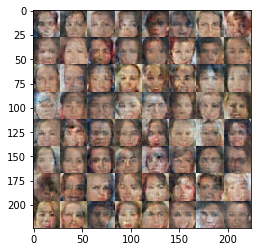

Epoch 2/4... Discriminator Loss: 1.2856... Generator Loss: 0.4417
Epoch 2/4... Discriminator Loss: 1.3544... Generator Loss: 0.9312
Epoch 2/4... Discriminator Loss: 2.0030... Generator Loss: 0.3632
Epoch 2/4... Discriminator Loss: 1.6319... Generator Loss: 0.3464
Epoch 2/4... Discriminator Loss: 1.7132... Generator Loss: 0.5695
Epoch 2/4... Discriminator Loss: 1.4218... Generator Loss: 0.9757
Epoch 2/4... Discriminator Loss: 2.2474... Generator Loss: 0.1362
Epoch 2/4... Discriminator Loss: 1.4462... Generator Loss: 0.4618
Epoch 2/4... Discriminator Loss: 1.6987... Generator Loss: 0.3305
Epoch 2/4... Discriminator Loss: 1.9897... Generator Loss: 0.1714


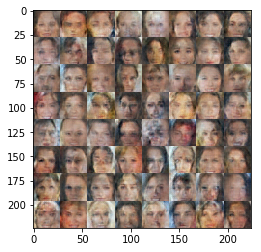

Epoch 2/4... Discriminator Loss: 1.5491... Generator Loss: 0.3183
Epoch 2/4... Discriminator Loss: 1.9816... Generator Loss: 0.1862
Epoch 2/4... Discriminator Loss: 1.5762... Generator Loss: 0.3963
Epoch 2/4... Discriminator Loss: 1.8828... Generator Loss: 0.2425
Epoch 2/4... Discriminator Loss: 1.8512... Generator Loss: 0.2411
Epoch 2/4... Discriminator Loss: 1.5158... Generator Loss: 0.3954
Epoch 2/4... Discriminator Loss: 1.7826... Generator Loss: 0.2396
Epoch 2/4... Discriminator Loss: 1.8624... Generator Loss: 0.2046
Epoch 2/4... Discriminator Loss: 1.6674... Generator Loss: 0.4815
Epoch 2/4... Discriminator Loss: 2.0345... Generator Loss: 0.3696


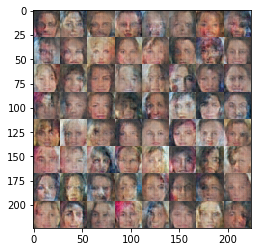

Epoch 2/4... Discriminator Loss: 1.8652... Generator Loss: 0.2101
Epoch 2/4... Discriminator Loss: 2.0090... Generator Loss: 0.1920
Epoch 2/4... Discriminator Loss: 1.7136... Generator Loss: 0.3512
Epoch 2/4... Discriminator Loss: 1.7586... Generator Loss: 0.2545
Epoch 2/4... Discriminator Loss: 2.0279... Generator Loss: 0.5486
Epoch 2/4... Discriminator Loss: 1.8029... Generator Loss: 0.2175
Epoch 3/4... Discriminator Loss: 1.9226... Generator Loss: 0.1983
Epoch 3/4... Discriminator Loss: 1.6572... Generator Loss: 0.3628
Epoch 3/4... Discriminator Loss: 1.8831... Generator Loss: 0.3692
Epoch 3/4... Discriminator Loss: 1.9638... Generator Loss: 0.1950
Epoch 3/4... Discriminator Loss: 1.5848... Generator Loss: 0.8744
Epoch 3/4... Discriminator Loss: 2.0422... Generator Loss: 0.2554
Epoch 3/4... Discriminator Loss: 1.2959... Generator Loss: 0.7173
Epoch 3/4... Discriminator Loss: 1.3688... Generator Loss: 0.8065
Epoch 3/4... Discriminator Loss: 1.3982... Generator Loss: 0.6206
Epoch 3/4.

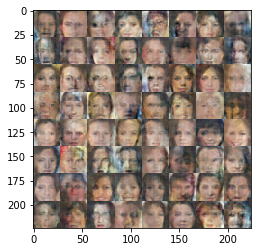

Epoch 3/4... Discriminator Loss: 1.6812... Generator Loss: 0.4404
Epoch 3/4... Discriminator Loss: 2.0681... Generator Loss: 0.9241
Epoch 3/4... Discriminator Loss: 1.9620... Generator Loss: 0.2109
Epoch 3/4... Discriminator Loss: 1.4551... Generator Loss: 0.6198
Epoch 3/4... Discriminator Loss: 1.8302... Generator Loss: 0.2382
Epoch 3/4... Discriminator Loss: 1.6774... Generator Loss: 0.5883
Epoch 3/4... Discriminator Loss: 1.6325... Generator Loss: 0.4790
Epoch 3/4... Discriminator Loss: 2.0243... Generator Loss: 0.1594
Epoch 3/4... Discriminator Loss: 1.6412... Generator Loss: 0.2650
Epoch 3/4... Discriminator Loss: 2.1504... Generator Loss: 0.1516


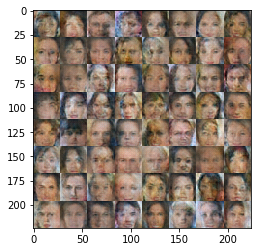

Epoch 3/4... Discriminator Loss: 1.8084... Generator Loss: 0.2830
Epoch 3/4... Discriminator Loss: 1.8224... Generator Loss: 0.3412
Epoch 3/4... Discriminator Loss: 2.1923... Generator Loss: 0.1547
Epoch 3/4... Discriminator Loss: 1.6588... Generator Loss: 0.5111
Epoch 3/4... Discriminator Loss: 1.4768... Generator Loss: 0.3641
Epoch 3/4... Discriminator Loss: 2.2873... Generator Loss: 0.1441
Epoch 3/4... Discriminator Loss: 1.7547... Generator Loss: 0.3307
Epoch 3/4... Discriminator Loss: 2.2872... Generator Loss: 0.9566
Epoch 3/4... Discriminator Loss: 1.6487... Generator Loss: 0.4728
Epoch 3/4... Discriminator Loss: 1.7595... Generator Loss: 0.2610


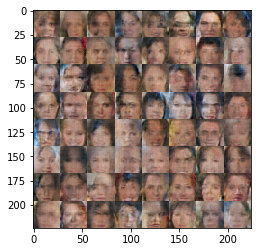

Epoch 3/4... Discriminator Loss: 1.4918... Generator Loss: 0.5493
Epoch 3/4... Discriminator Loss: 2.0862... Generator Loss: 0.1849
Epoch 3/4... Discriminator Loss: 2.3940... Generator Loss: 0.1140
Epoch 3/4... Discriminator Loss: 2.1068... Generator Loss: 1.0154
Epoch 3/4... Discriminator Loss: 2.0294... Generator Loss: 0.4488
Epoch 3/4... Discriminator Loss: 2.2020... Generator Loss: 0.1297
Epoch 3/4... Discriminator Loss: 2.0812... Generator Loss: 0.2438
Epoch 3/4... Discriminator Loss: 2.3067... Generator Loss: 0.1332
Epoch 3/4... Discriminator Loss: 1.6108... Generator Loss: 0.5033
Epoch 3/4... Discriminator Loss: 2.0196... Generator Loss: 0.2837


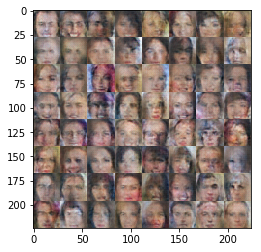

Epoch 3/4... Discriminator Loss: 1.6482... Generator Loss: 0.5027
Epoch 3/4... Discriminator Loss: 1.7153... Generator Loss: 0.3701
Epoch 3/4... Discriminator Loss: 2.2650... Generator Loss: 0.1523
Epoch 3/4... Discriminator Loss: 1.4801... Generator Loss: 0.4588
Epoch 3/4... Discriminator Loss: 1.9225... Generator Loss: 0.2385
Epoch 3/4... Discriminator Loss: 2.1809... Generator Loss: 0.7633
Epoch 3/4... Discriminator Loss: 1.7296... Generator Loss: 0.4551
Epoch 3/4... Discriminator Loss: 1.6415... Generator Loss: 0.9046
Epoch 3/4... Discriminator Loss: 1.8613... Generator Loss: 0.2302
Epoch 3/4... Discriminator Loss: 1.5040... Generator Loss: 0.4490


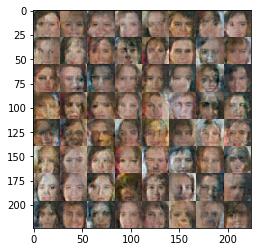

Epoch 3/4... Discriminator Loss: 2.0906... Generator Loss: 0.1593
Epoch 3/4... Discriminator Loss: 1.6530... Generator Loss: 0.3802
Epoch 3/4... Discriminator Loss: 1.5938... Generator Loss: 0.4639
Epoch 3/4... Discriminator Loss: 1.7834... Generator Loss: 0.9465
Epoch 3/4... Discriminator Loss: 1.7215... Generator Loss: 0.6221
Epoch 3/4... Discriminator Loss: 1.4838... Generator Loss: 0.4589
Epoch 3/4... Discriminator Loss: 1.4427... Generator Loss: 0.6378
Epoch 3/4... Discriminator Loss: 2.0143... Generator Loss: 0.1745
Epoch 3/4... Discriminator Loss: 1.5093... Generator Loss: 0.5704
Epoch 3/4... Discriminator Loss: 1.7470... Generator Loss: 0.5271


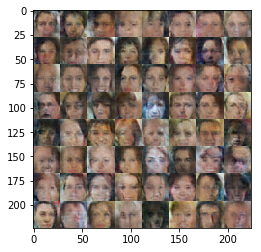

Epoch 3/4... Discriminator Loss: 1.8203... Generator Loss: 0.3120
Epoch 3/4... Discriminator Loss: 1.9221... Generator Loss: 0.1946
Epoch 3/4... Discriminator Loss: 1.8093... Generator Loss: 0.4198
Epoch 3/4... Discriminator Loss: 1.5688... Generator Loss: 0.3456
Epoch 3/4... Discriminator Loss: 1.7859... Generator Loss: 0.2505
Epoch 3/4... Discriminator Loss: 1.6152... Generator Loss: 0.3169
Epoch 3/4... Discriminator Loss: 1.9352... Generator Loss: 0.2673
Epoch 3/4... Discriminator Loss: 1.5761... Generator Loss: 0.5385
Epoch 3/4... Discriminator Loss: 1.4328... Generator Loss: 0.4641
Epoch 3/4... Discriminator Loss: 1.6669... Generator Loss: 0.5955


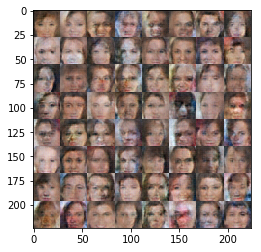

Epoch 3/4... Discriminator Loss: 1.5835... Generator Loss: 0.3589
Epoch 3/4... Discriminator Loss: 1.6753... Generator Loss: 0.3792
Epoch 3/4... Discriminator Loss: 1.9090... Generator Loss: 0.1946
Epoch 3/4... Discriminator Loss: 2.0020... Generator Loss: 0.2689
Epoch 3/4... Discriminator Loss: 1.9162... Generator Loss: 0.6035
Epoch 3/4... Discriminator Loss: 2.2595... Generator Loss: 0.1200
Epoch 3/4... Discriminator Loss: 2.2604... Generator Loss: 0.1320
Epoch 3/4... Discriminator Loss: 2.2327... Generator Loss: 0.7220
Epoch 3/4... Discriminator Loss: 1.5656... Generator Loss: 0.3507
Epoch 3/4... Discriminator Loss: 1.9215... Generator Loss: 0.2437


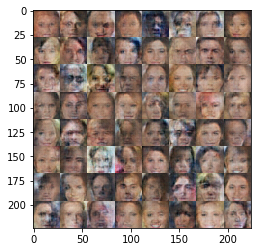

Epoch 3/4... Discriminator Loss: 1.7974... Generator Loss: 0.2803
Epoch 3/4... Discriminator Loss: 1.5003... Generator Loss: 0.4467
Epoch 3/4... Discriminator Loss: 2.5582... Generator Loss: 0.1014
Epoch 3/4... Discriminator Loss: 1.9480... Generator Loss: 0.2435
Epoch 3/4... Discriminator Loss: 1.7037... Generator Loss: 0.2561
Epoch 3/4... Discriminator Loss: 2.0628... Generator Loss: 0.1859
Epoch 3/4... Discriminator Loss: 2.4193... Generator Loss: 0.1245
Epoch 3/4... Discriminator Loss: 1.5175... Generator Loss: 0.4861
Epoch 3/4... Discriminator Loss: 2.0132... Generator Loss: 0.2703
Epoch 3/4... Discriminator Loss: 1.6553... Generator Loss: 0.3669


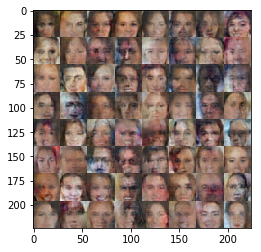

Epoch 3/4... Discriminator Loss: 1.9390... Generator Loss: 0.2874
Epoch 3/4... Discriminator Loss: 1.8081... Generator Loss: 0.2943
Epoch 3/4... Discriminator Loss: 1.5924... Generator Loss: 0.5090
Epoch 3/4... Discriminator Loss: 2.1204... Generator Loss: 0.1495
Epoch 3/4... Discriminator Loss: 2.0425... Generator Loss: 0.1761
Epoch 3/4... Discriminator Loss: 1.7204... Generator Loss: 0.2645
Epoch 3/4... Discriminator Loss: 2.2977... Generator Loss: 0.1294
Epoch 3/4... Discriminator Loss: 2.5903... Generator Loss: 0.1188
Epoch 3/4... Discriminator Loss: 1.6489... Generator Loss: 0.3782
Epoch 3/4... Discriminator Loss: 1.8898... Generator Loss: 0.2419


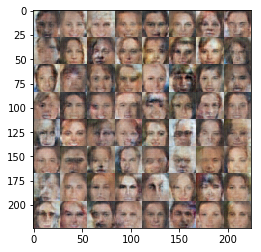

Epoch 3/4... Discriminator Loss: 1.4109... Generator Loss: 0.7437
Epoch 3/4... Discriminator Loss: 1.6807... Generator Loss: 0.2530
Epoch 3/4... Discriminator Loss: 2.0469... Generator Loss: 0.1773
Epoch 3/4... Discriminator Loss: 1.5754... Generator Loss: 0.5299
Epoch 3/4... Discriminator Loss: 2.1674... Generator Loss: 0.6190
Epoch 3/4... Discriminator Loss: 1.8846... Generator Loss: 0.2056
Epoch 3/4... Discriminator Loss: 2.0838... Generator Loss: 0.1605
Epoch 3/4... Discriminator Loss: 1.5892... Generator Loss: 0.7749
Epoch 3/4... Discriminator Loss: 1.7544... Generator Loss: 0.8197
Epoch 3/4... Discriminator Loss: 1.7387... Generator Loss: 0.3969


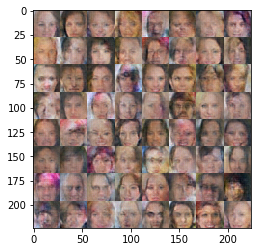

Epoch 3/4... Discriminator Loss: 1.7112... Generator Loss: 0.3565
Epoch 3/4... Discriminator Loss: 1.6412... Generator Loss: 0.5538
Epoch 3/4... Discriminator Loss: 1.6151... Generator Loss: 0.4279
Epoch 3/4... Discriminator Loss: 1.5602... Generator Loss: 0.7565
Epoch 3/4... Discriminator Loss: 2.1766... Generator Loss: 0.1600
Epoch 3/4... Discriminator Loss: 1.8284... Generator Loss: 0.2419
Epoch 3/4... Discriminator Loss: 1.5704... Generator Loss: 0.8802
Epoch 3/4... Discriminator Loss: 1.8575... Generator Loss: 0.2009
Epoch 3/4... Discriminator Loss: 1.8398... Generator Loss: 0.5056
Epoch 3/4... Discriminator Loss: 1.5548... Generator Loss: 0.3722


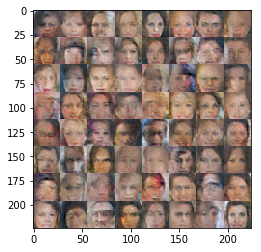

Epoch 3/4... Discriminator Loss: 1.6673... Generator Loss: 0.5297
Epoch 3/4... Discriminator Loss: 1.9403... Generator Loss: 0.2134
Epoch 3/4... Discriminator Loss: 1.8382... Generator Loss: 0.2122
Epoch 3/4... Discriminator Loss: 2.0951... Generator Loss: 0.1552
Epoch 3/4... Discriminator Loss: 1.9967... Generator Loss: 0.1781
Epoch 3/4... Discriminator Loss: 1.8598... Generator Loss: 0.4033
Epoch 3/4... Discriminator Loss: 1.6295... Generator Loss: 0.7374
Epoch 3/4... Discriminator Loss: 1.8739... Generator Loss: 0.2803
Epoch 3/4... Discriminator Loss: 1.7529... Generator Loss: 0.2515
Epoch 3/4... Discriminator Loss: 2.0278... Generator Loss: 0.7659


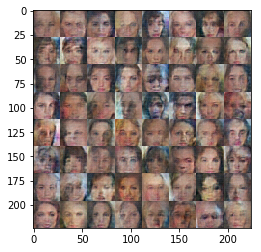

Epoch 3/4... Discriminator Loss: 1.7542... Generator Loss: 0.3419
Epoch 3/4... Discriminator Loss: 1.7764... Generator Loss: 0.3317
Epoch 3/4... Discriminator Loss: 2.1841... Generator Loss: 0.1650
Epoch 3/4... Discriminator Loss: 1.3707... Generator Loss: 0.6146
Epoch 3/4... Discriminator Loss: 2.0633... Generator Loss: 0.2520
Epoch 3/4... Discriminator Loss: 1.7890... Generator Loss: 0.5292
Epoch 3/4... Discriminator Loss: 1.9255... Generator Loss: 0.3630
Epoch 3/4... Discriminator Loss: 1.9108... Generator Loss: 0.2510
Epoch 3/4... Discriminator Loss: 1.3040... Generator Loss: 0.9111
Epoch 3/4... Discriminator Loss: 1.8889... Generator Loss: 0.3560


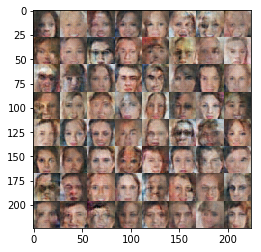

Epoch 3/4... Discriminator Loss: 1.7535... Generator Loss: 0.3587
Epoch 3/4... Discriminator Loss: 1.3357... Generator Loss: 0.5772
Epoch 3/4... Discriminator Loss: 1.8259... Generator Loss: 0.2496
Epoch 3/4... Discriminator Loss: 1.5252... Generator Loss: 0.4250
Epoch 3/4... Discriminator Loss: 1.7452... Generator Loss: 0.4410
Epoch 3/4... Discriminator Loss: 1.6768... Generator Loss: 0.5958
Epoch 3/4... Discriminator Loss: 1.7232... Generator Loss: 0.3782
Epoch 3/4... Discriminator Loss: 1.6999... Generator Loss: 0.2849
Epoch 3/4... Discriminator Loss: 2.1109... Generator Loss: 0.2010
Epoch 3/4... Discriminator Loss: 1.9994... Generator Loss: 0.1776


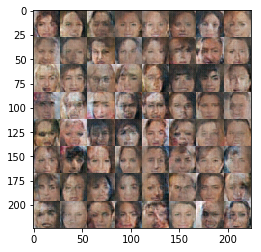

Epoch 3/4... Discriminator Loss: 2.0458... Generator Loss: 0.6957
Epoch 3/4... Discriminator Loss: 1.2691... Generator Loss: 0.9443
Epoch 3/4... Discriminator Loss: 1.8597... Generator Loss: 0.2966
Epoch 3/4... Discriminator Loss: 1.5565... Generator Loss: 0.8029
Epoch 3/4... Discriminator Loss: 1.7627... Generator Loss: 0.2659
Epoch 3/4... Discriminator Loss: 2.1719... Generator Loss: 0.1492
Epoch 3/4... Discriminator Loss: 1.6468... Generator Loss: 0.3899
Epoch 3/4... Discriminator Loss: 1.7020... Generator Loss: 0.4995
Epoch 3/4... Discriminator Loss: 1.7523... Generator Loss: 0.3358
Epoch 3/4... Discriminator Loss: 2.1633... Generator Loss: 0.1438


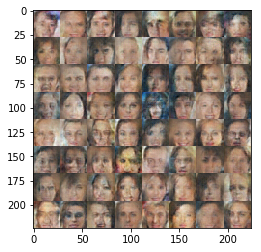

Epoch 3/4... Discriminator Loss: 1.5879... Generator Loss: 0.5906
Epoch 3/4... Discriminator Loss: 1.6418... Generator Loss: 0.8037
Epoch 3/4... Discriminator Loss: 1.9651... Generator Loss: 0.2222
Epoch 3/4... Discriminator Loss: 2.1100... Generator Loss: 0.1683
Epoch 3/4... Discriminator Loss: 2.3301... Generator Loss: 0.1191
Epoch 3/4... Discriminator Loss: 1.8276... Generator Loss: 0.2168
Epoch 3/4... Discriminator Loss: 2.1875... Generator Loss: 0.1610
Epoch 3/4... Discriminator Loss: 1.6563... Generator Loss: 0.4039
Epoch 3/4... Discriminator Loss: 1.7040... Generator Loss: 0.3073
Epoch 3/4... Discriminator Loss: 2.0135... Generator Loss: 0.1964


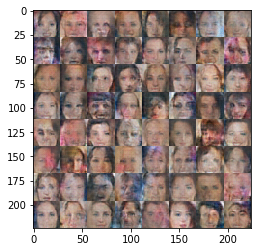

Epoch 3/4... Discriminator Loss: 1.7987... Generator Loss: 0.2414
Epoch 3/4... Discriminator Loss: 1.7743... Generator Loss: 0.2478
Epoch 3/4... Discriminator Loss: 1.6799... Generator Loss: 0.3076
Epoch 3/4... Discriminator Loss: 1.9827... Generator Loss: 0.8140
Epoch 3/4... Discriminator Loss: 1.6040... Generator Loss: 0.3364
Epoch 3/4... Discriminator Loss: 2.0530... Generator Loss: 0.1595
Epoch 3/4... Discriminator Loss: 1.6078... Generator Loss: 0.4501
Epoch 3/4... Discriminator Loss: 2.0009... Generator Loss: 0.2212
Epoch 3/4... Discriminator Loss: 1.9278... Generator Loss: 0.2017
Epoch 3/4... Discriminator Loss: 1.6442... Generator Loss: 0.4627


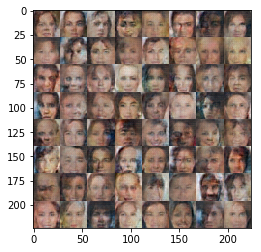

Epoch 3/4... Discriminator Loss: 1.3158... Generator Loss: 0.9248
Epoch 3/4... Discriminator Loss: 1.9338... Generator Loss: 0.2216
Epoch 3/4... Discriminator Loss: 2.2578... Generator Loss: 0.1434
Epoch 3/4... Discriminator Loss: 1.8212... Generator Loss: 0.9937
Epoch 3/4... Discriminator Loss: 1.9725... Generator Loss: 0.2721
Epoch 3/4... Discriminator Loss: 1.7556... Generator Loss: 0.2585
Epoch 3/4... Discriminator Loss: 2.2370... Generator Loss: 0.1683
Epoch 3/4... Discriminator Loss: 1.7206... Generator Loss: 0.3944
Epoch 3/4... Discriminator Loss: 1.6238... Generator Loss: 0.5563
Epoch 3/4... Discriminator Loss: 1.9720... Generator Loss: 0.3330


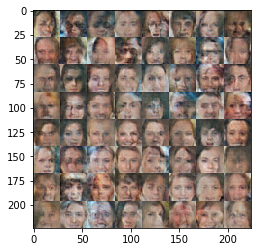

Epoch 3/4... Discriminator Loss: 1.7589... Generator Loss: 0.2425
Epoch 3/4... Discriminator Loss: 1.8288... Generator Loss: 0.2344
Epoch 3/4... Discriminator Loss: 1.9827... Generator Loss: 0.2152
Epoch 3/4... Discriminator Loss: 1.5805... Generator Loss: 0.3895
Epoch 3/4... Discriminator Loss: 2.1022... Generator Loss: 0.1743
Epoch 3/4... Discriminator Loss: 1.6882... Generator Loss: 0.4607
Epoch 3/4... Discriminator Loss: 1.7149... Generator Loss: 0.3432
Epoch 3/4... Discriminator Loss: 1.9495... Generator Loss: 0.6485
Epoch 3/4... Discriminator Loss: 1.6707... Generator Loss: 0.2857
Epoch 3/4... Discriminator Loss: 1.4828... Generator Loss: 0.5717


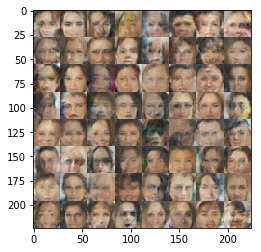

Epoch 3/4... Discriminator Loss: 1.5566... Generator Loss: 0.5776
Epoch 3/4... Discriminator Loss: 1.9163... Generator Loss: 0.2216
Epoch 3/4... Discriminator Loss: 1.6008... Generator Loss: 0.2653
Epoch 3/4... Discriminator Loss: 1.8065... Generator Loss: 0.7910
Epoch 3/4... Discriminator Loss: 1.9155... Generator Loss: 0.2161
Epoch 3/4... Discriminator Loss: 1.6448... Generator Loss: 0.5956
Epoch 3/4... Discriminator Loss: 1.5417... Generator Loss: 0.4859
Epoch 3/4... Discriminator Loss: 1.5196... Generator Loss: 0.4896
Epoch 3/4... Discriminator Loss: 1.7892... Generator Loss: 0.2531
Epoch 3/4... Discriminator Loss: 1.3611... Generator Loss: 0.7963


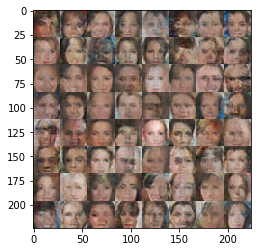

Epoch 3/4... Discriminator Loss: 1.7860... Generator Loss: 0.3982
Epoch 3/4... Discriminator Loss: 1.9223... Generator Loss: 0.2187
Epoch 3/4... Discriminator Loss: 1.7078... Generator Loss: 0.3358
Epoch 3/4... Discriminator Loss: 1.4202... Generator Loss: 0.3923
Epoch 3/4... Discriminator Loss: 1.6337... Generator Loss: 0.6177
Epoch 3/4... Discriminator Loss: 1.5700... Generator Loss: 0.5201
Epoch 3/4... Discriminator Loss: 1.9677... Generator Loss: 0.2095
Epoch 3/4... Discriminator Loss: 1.6440... Generator Loss: 0.5304
Epoch 3/4... Discriminator Loss: 1.6974... Generator Loss: 0.3637
Epoch 3/4... Discriminator Loss: 1.6444... Generator Loss: 0.3075


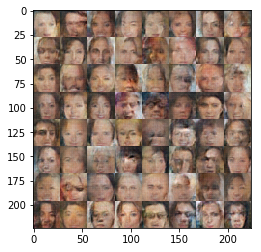

Epoch 3/4... Discriminator Loss: 2.0403... Generator Loss: 0.1841
Epoch 3/4... Discriminator Loss: 1.8879... Generator Loss: 0.2250
Epoch 3/4... Discriminator Loss: 1.8806... Generator Loss: 0.4740
Epoch 3/4... Discriminator Loss: 2.0802... Generator Loss: 0.2563
Epoch 3/4... Discriminator Loss: 1.6241... Generator Loss: 0.5022
Epoch 3/4... Discriminator Loss: 1.8266... Generator Loss: 0.2363
Epoch 3/4... Discriminator Loss: 1.7427... Generator Loss: 0.5831
Epoch 3/4... Discriminator Loss: 1.9463... Generator Loss: 0.3833
Epoch 3/4... Discriminator Loss: 1.4728... Generator Loss: 0.5748
Epoch 3/4... Discriminator Loss: 1.7998... Generator Loss: 0.2480


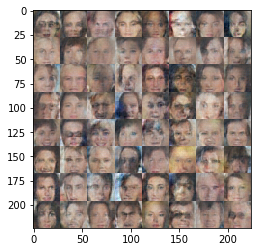

Epoch 3/4... Discriminator Loss: 1.7054... Generator Loss: 0.3004
Epoch 3/4... Discriminator Loss: 1.9581... Generator Loss: 0.2963
Epoch 3/4... Discriminator Loss: 1.9030... Generator Loss: 0.3199
Epoch 3/4... Discriminator Loss: 2.3353... Generator Loss: 0.1274
Epoch 3/4... Discriminator Loss: 1.9614... Generator Loss: 1.0475
Epoch 3/4... Discriminator Loss: 1.5748... Generator Loss: 0.5528
Epoch 3/4... Discriminator Loss: 2.1048... Generator Loss: 0.1636
Epoch 3/4... Discriminator Loss: 1.7604... Generator Loss: 0.2314
Epoch 3/4... Discriminator Loss: 1.8800... Generator Loss: 0.2257
Epoch 3/4... Discriminator Loss: 1.8702... Generator Loss: 0.2407


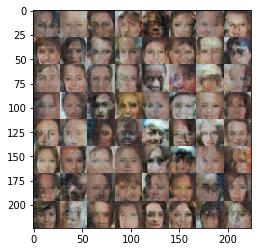

Epoch 3/4... Discriminator Loss: 1.5525... Generator Loss: 0.6733
Epoch 3/4... Discriminator Loss: 2.1027... Generator Loss: 0.1515
Epoch 3/4... Discriminator Loss: 1.9345... Generator Loss: 0.1935
Epoch 3/4... Discriminator Loss: 1.6016... Generator Loss: 0.3756
Epoch 3/4... Discriminator Loss: 1.6853... Generator Loss: 0.2917
Epoch 3/4... Discriminator Loss: 1.6334... Generator Loss: 0.4648
Epoch 3/4... Discriminator Loss: 1.6191... Generator Loss: 0.2688
Epoch 3/4... Discriminator Loss: 1.9988... Generator Loss: 0.2505
Epoch 3/4... Discriminator Loss: 1.8976... Generator Loss: 0.2425
Epoch 3/4... Discriminator Loss: 1.5354... Generator Loss: 0.5357


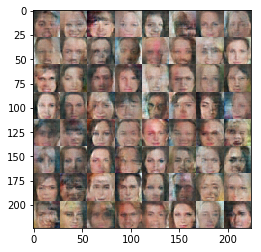

Epoch 3/4... Discriminator Loss: 1.7963... Generator Loss: 0.2752
Epoch 3/4... Discriminator Loss: 1.4848... Generator Loss: 0.7983
Epoch 3/4... Discriminator Loss: 1.7920... Generator Loss: 0.2968
Epoch 3/4... Discriminator Loss: 2.0617... Generator Loss: 0.2164
Epoch 3/4... Discriminator Loss: 2.0814... Generator Loss: 0.2151
Epoch 3/4... Discriminator Loss: 1.9214... Generator Loss: 0.1820
Epoch 3/4... Discriminator Loss: 1.6978... Generator Loss: 0.4985
Epoch 3/4... Discriminator Loss: 1.8025... Generator Loss: 0.6247
Epoch 3/4... Discriminator Loss: 1.3570... Generator Loss: 0.5430
Epoch 3/4... Discriminator Loss: 1.6452... Generator Loss: 0.3118


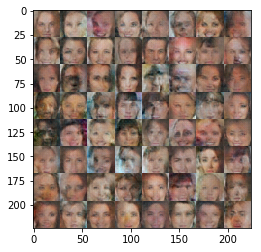

Epoch 3/4... Discriminator Loss: 1.7038... Generator Loss: 0.2821
Epoch 3/4... Discriminator Loss: 1.9174... Generator Loss: 0.4128
Epoch 3/4... Discriminator Loss: 1.7151... Generator Loss: 0.2896
Epoch 3/4... Discriminator Loss: 1.7860... Generator Loss: 0.2686
Epoch 3/4... Discriminator Loss: 1.7709... Generator Loss: 0.2700
Epoch 3/4... Discriminator Loss: 1.9432... Generator Loss: 1.4760
Epoch 3/4... Discriminator Loss: 1.9375... Generator Loss: 0.1814
Epoch 3/4... Discriminator Loss: 1.6536... Generator Loss: 0.6283
Epoch 3/4... Discriminator Loss: 2.0724... Generator Loss: 0.1862
Epoch 3/4... Discriminator Loss: 1.8316... Generator Loss: 0.3753


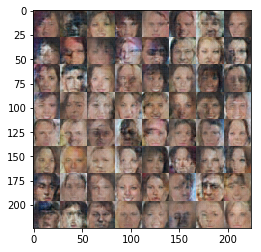

Epoch 3/4... Discriminator Loss: 1.8388... Generator Loss: 0.2546
Epoch 3/4... Discriminator Loss: 1.8740... Generator Loss: 0.1893
Epoch 3/4... Discriminator Loss: 1.9879... Generator Loss: 0.3075
Epoch 3/4... Discriminator Loss: 1.8446... Generator Loss: 0.2493
Epoch 3/4... Discriminator Loss: 1.8464... Generator Loss: 0.2350
Epoch 3/4... Discriminator Loss: 1.8655... Generator Loss: 0.2535
Epoch 3/4... Discriminator Loss: 1.5549... Generator Loss: 0.3752
Epoch 3/4... Discriminator Loss: 1.7282... Generator Loss: 0.3526
Epoch 3/4... Discriminator Loss: 2.2949... Generator Loss: 0.1284
Epoch 3/4... Discriminator Loss: 1.7879... Generator Loss: 0.2545


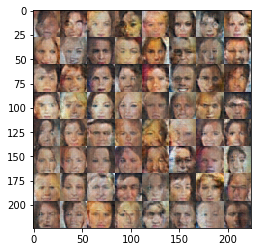

Epoch 3/4... Discriminator Loss: 1.7198... Generator Loss: 0.2464
Epoch 3/4... Discriminator Loss: 1.5153... Generator Loss: 0.4846
Epoch 3/4... Discriminator Loss: 1.7027... Generator Loss: 0.3194
Epoch 3/4... Discriminator Loss: 1.6949... Generator Loss: 0.3224
Epoch 3/4... Discriminator Loss: 1.7428... Generator Loss: 0.6939
Epoch 3/4... Discriminator Loss: 1.8741... Generator Loss: 0.2260
Epoch 3/4... Discriminator Loss: 1.5499... Generator Loss: 0.4062
Epoch 3/4... Discriminator Loss: 1.3530... Generator Loss: 0.4945
Epoch 3/4... Discriminator Loss: 1.5010... Generator Loss: 0.3841
Epoch 3/4... Discriminator Loss: 1.9982... Generator Loss: 0.2195


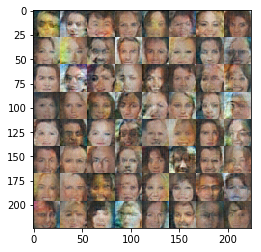

Epoch 3/4... Discriminator Loss: 1.7628... Generator Loss: 0.2824
Epoch 3/4... Discriminator Loss: 1.9081... Generator Loss: 0.5330
Epoch 3/4... Discriminator Loss: 1.6069... Generator Loss: 0.4959
Epoch 3/4... Discriminator Loss: 1.6971... Generator Loss: 0.3919
Epoch 3/4... Discriminator Loss: 1.6120... Generator Loss: 0.6588
Epoch 3/4... Discriminator Loss: 1.5687... Generator Loss: 0.3446
Epoch 3/4... Discriminator Loss: 1.3787... Generator Loss: 0.5508
Epoch 3/4... Discriminator Loss: 1.7375... Generator Loss: 0.2696
Epoch 3/4... Discriminator Loss: 1.7618... Generator Loss: 0.2345
Epoch 3/4... Discriminator Loss: 2.1725... Generator Loss: 0.1471


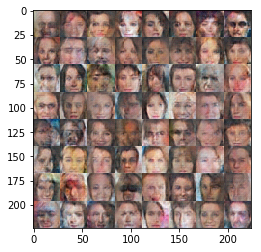

Epoch 3/4... Discriminator Loss: 1.7061... Generator Loss: 0.8539
Epoch 3/4... Discriminator Loss: 1.8293... Generator Loss: 0.2177
Epoch 3/4... Discriminator Loss: 1.7128... Generator Loss: 0.4473
Epoch 3/4... Discriminator Loss: 1.8525... Generator Loss: 0.2820
Epoch 3/4... Discriminator Loss: 2.0374... Generator Loss: 0.3560
Epoch 3/4... Discriminator Loss: 1.9274... Generator Loss: 0.2159
Epoch 3/4... Discriminator Loss: 1.7468... Generator Loss: 0.5273
Epoch 3/4... Discriminator Loss: 1.6159... Generator Loss: 0.5324
Epoch 3/4... Discriminator Loss: 2.1325... Generator Loss: 0.1559
Epoch 3/4... Discriminator Loss: 1.9416... Generator Loss: 0.3349


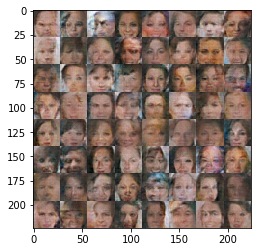

Epoch 3/4... Discriminator Loss: 1.3754... Generator Loss: 0.4582
Epoch 3/4... Discriminator Loss: 1.6599... Generator Loss: 0.3785
Epoch 3/4... Discriminator Loss: 1.7046... Generator Loss: 0.4937
Epoch 3/4... Discriminator Loss: 1.5964... Generator Loss: 0.4471
Epoch 3/4... Discriminator Loss: 1.7395... Generator Loss: 0.3097
Epoch 3/4... Discriminator Loss: 1.6556... Generator Loss: 0.3263
Epoch 4/4... Discriminator Loss: 1.6781... Generator Loss: 0.4205
Epoch 4/4... Discriminator Loss: 1.8149... Generator Loss: 0.3108
Epoch 4/4... Discriminator Loss: 1.7293... Generator Loss: 0.3415
Epoch 4/4... Discriminator Loss: 1.9832... Generator Loss: 0.3464
Epoch 4/4... Discriminator Loss: 1.5170... Generator Loss: 0.5696
Epoch 4/4... Discriminator Loss: 1.5286... Generator Loss: 0.4733
Epoch 4/4... Discriminator Loss: 1.5821... Generator Loss: 0.2919
Epoch 4/4... Discriminator Loss: 1.7762... Generator Loss: 0.2569
Epoch 4/4... Discriminator Loss: 2.0156... Generator Loss: 0.1913
Epoch 4/4.

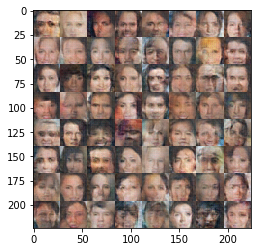

Epoch 4/4... Discriminator Loss: 1.4361... Generator Loss: 0.6010
Epoch 4/4... Discriminator Loss: 1.7246... Generator Loss: 0.3507
Epoch 4/4... Discriminator Loss: 1.6293... Generator Loss: 0.4435
Epoch 4/4... Discriminator Loss: 1.6771... Generator Loss: 0.3378
Epoch 4/4... Discriminator Loss: 1.6108... Generator Loss: 0.3160
Epoch 4/4... Discriminator Loss: 1.6648... Generator Loss: 0.4066
Epoch 4/4... Discriminator Loss: 2.0577... Generator Loss: 0.2899
Epoch 4/4... Discriminator Loss: 1.9442... Generator Loss: 0.2332
Epoch 4/4... Discriminator Loss: 1.6626... Generator Loss: 0.3336
Epoch 4/4... Discriminator Loss: 1.8920... Generator Loss: 0.1995


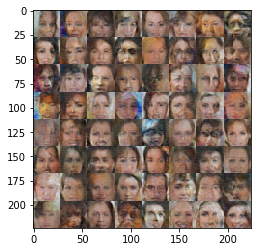

Epoch 4/4... Discriminator Loss: 2.0378... Generator Loss: 0.5746
Epoch 4/4... Discriminator Loss: 1.7757... Generator Loss: 0.3225
Epoch 4/4... Discriminator Loss: 1.8001... Generator Loss: 0.2223
Epoch 4/4... Discriminator Loss: 1.8311... Generator Loss: 0.2153
Epoch 4/4... Discriminator Loss: 1.7589... Generator Loss: 0.4147
Epoch 4/4... Discriminator Loss: 1.5128... Generator Loss: 0.3581
Epoch 4/4... Discriminator Loss: 1.5391... Generator Loss: 0.7041
Epoch 4/4... Discriminator Loss: 1.7731... Generator Loss: 0.3100
Epoch 4/4... Discriminator Loss: 1.7408... Generator Loss: 0.3178
Epoch 4/4... Discriminator Loss: 1.7890... Generator Loss: 0.2593


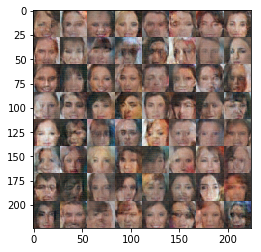

Epoch 4/4... Discriminator Loss: 1.7271... Generator Loss: 0.4948
Epoch 4/4... Discriminator Loss: 2.0119... Generator Loss: 0.2157
Epoch 4/4... Discriminator Loss: 1.7157... Generator Loss: 0.3754
Epoch 4/4... Discriminator Loss: 1.6787... Generator Loss: 0.4302
Epoch 4/4... Discriminator Loss: 1.5513... Generator Loss: 0.5158
Epoch 4/4... Discriminator Loss: 1.7518... Generator Loss: 0.2361
Epoch 4/4... Discriminator Loss: 1.8012... Generator Loss: 0.3804
Epoch 4/4... Discriminator Loss: 2.0281... Generator Loss: 0.2061
Epoch 4/4... Discriminator Loss: 2.0447... Generator Loss: 0.1622
Epoch 4/4... Discriminator Loss: 1.8517... Generator Loss: 0.6407


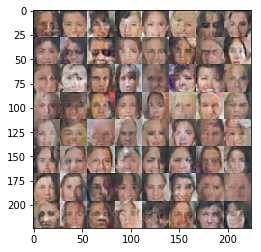

Epoch 4/4... Discriminator Loss: 1.6509... Generator Loss: 0.5810
Epoch 4/4... Discriminator Loss: 1.9778... Generator Loss: 0.1826
Epoch 4/4... Discriminator Loss: 1.8501... Generator Loss: 0.7340
Epoch 4/4... Discriminator Loss: 1.6075... Generator Loss: 0.4236
Epoch 4/4... Discriminator Loss: 1.5826... Generator Loss: 0.3855
Epoch 4/4... Discriminator Loss: 1.8329... Generator Loss: 0.3192
Epoch 4/4... Discriminator Loss: 1.7354... Generator Loss: 0.6037
Epoch 4/4... Discriminator Loss: 1.9420... Generator Loss: 0.1923
Epoch 4/4... Discriminator Loss: 1.8057... Generator Loss: 0.2294
Epoch 4/4... Discriminator Loss: 1.5783... Generator Loss: 1.1222


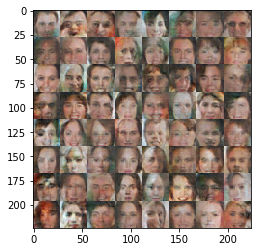

Epoch 4/4... Discriminator Loss: 1.8378... Generator Loss: 0.2113
Epoch 4/4... Discriminator Loss: 1.5686... Generator Loss: 0.5314
Epoch 4/4... Discriminator Loss: 1.6493... Generator Loss: 0.4425
Epoch 4/4... Discriminator Loss: 1.7779... Generator Loss: 0.3722
Epoch 4/4... Discriminator Loss: 1.7233... Generator Loss: 0.3189
Epoch 4/4... Discriminator Loss: 1.7477... Generator Loss: 0.2605
Epoch 4/4... Discriminator Loss: 1.5633... Generator Loss: 0.3250
Epoch 4/4... Discriminator Loss: 1.6645... Generator Loss: 0.3966
Epoch 4/4... Discriminator Loss: 1.7071... Generator Loss: 0.2736
Epoch 4/4... Discriminator Loss: 1.4239... Generator Loss: 0.5364


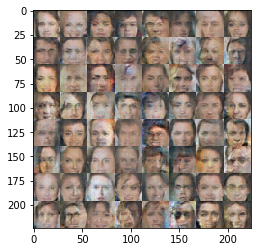

Epoch 4/4... Discriminator Loss: 1.4913... Generator Loss: 0.5760
Epoch 4/4... Discriminator Loss: 1.5222... Generator Loss: 0.3863
Epoch 4/4... Discriminator Loss: 1.8043... Generator Loss: 0.3034
Epoch 4/4... Discriminator Loss: 1.7451... Generator Loss: 0.7300
Epoch 4/4... Discriminator Loss: 1.5827... Generator Loss: 0.3249
Epoch 4/4... Discriminator Loss: 1.5996... Generator Loss: 0.3988
Epoch 4/4... Discriminator Loss: 1.6958... Generator Loss: 0.3208
Epoch 4/4... Discriminator Loss: 1.5695... Generator Loss: 0.5490
Epoch 4/4... Discriminator Loss: 1.5194... Generator Loss: 0.3689
Epoch 4/4... Discriminator Loss: 1.8438... Generator Loss: 0.2030


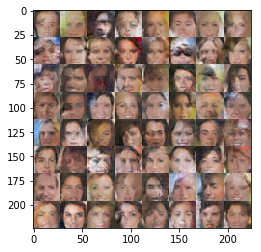

Epoch 4/4... Discriminator Loss: 1.9279... Generator Loss: 0.1746
Epoch 4/4... Discriminator Loss: 1.7648... Generator Loss: 0.2580
Epoch 4/4... Discriminator Loss: 1.6069... Generator Loss: 0.3702
Epoch 4/4... Discriminator Loss: 1.6947... Generator Loss: 0.2874
Epoch 4/4... Discriminator Loss: 1.6465... Generator Loss: 0.2884
Epoch 4/4... Discriminator Loss: 1.9883... Generator Loss: 0.1796
Epoch 4/4... Discriminator Loss: 1.6744... Generator Loss: 0.3781
Epoch 4/4... Discriminator Loss: 1.7832... Generator Loss: 0.4837
Epoch 4/4... Discriminator Loss: 1.6721... Generator Loss: 0.3599
Epoch 4/4... Discriminator Loss: 1.8106... Generator Loss: 0.4147


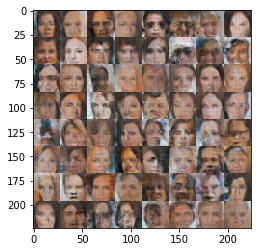

Epoch 4/4... Discriminator Loss: 1.7098... Generator Loss: 0.3346
Epoch 4/4... Discriminator Loss: 1.8317... Generator Loss: 0.2481
Epoch 4/4... Discriminator Loss: 1.8996... Generator Loss: 0.2223
Epoch 4/4... Discriminator Loss: 1.1860... Generator Loss: 0.9601
Epoch 4/4... Discriminator Loss: 2.0068... Generator Loss: 0.1930
Epoch 4/4... Discriminator Loss: 1.5170... Generator Loss: 0.4512
Epoch 4/4... Discriminator Loss: 1.9025... Generator Loss: 0.2345
Epoch 4/4... Discriminator Loss: 1.6471... Generator Loss: 0.4332
Epoch 4/4... Discriminator Loss: 2.0772... Generator Loss: 0.1836
Epoch 4/4... Discriminator Loss: 1.8735... Generator Loss: 0.2565


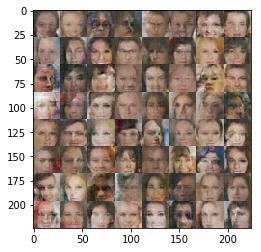

Epoch 4/4... Discriminator Loss: 1.6874... Generator Loss: 0.3172
Epoch 4/4... Discriminator Loss: 1.8133... Generator Loss: 0.2367
Epoch 4/4... Discriminator Loss: 1.9370... Generator Loss: 0.2445
Epoch 4/4... Discriminator Loss: 1.7907... Generator Loss: 0.2730
Epoch 4/4... Discriminator Loss: 1.6306... Generator Loss: 0.3401
Epoch 4/4... Discriminator Loss: 1.8075... Generator Loss: 0.2063
Epoch 4/4... Discriminator Loss: 1.6082... Generator Loss: 0.3993
Epoch 4/4... Discriminator Loss: 1.6886... Generator Loss: 0.2912
Epoch 4/4... Discriminator Loss: 2.0370... Generator Loss: 0.1715
Epoch 4/4... Discriminator Loss: 1.7497... Generator Loss: 0.2969


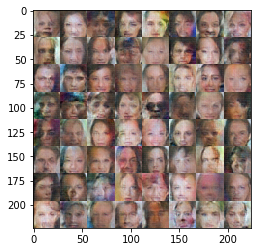

Epoch 4/4... Discriminator Loss: 1.9702... Generator Loss: 0.3300
Epoch 4/4... Discriminator Loss: 1.8777... Generator Loss: 0.2512
Epoch 4/4... Discriminator Loss: 1.7176... Generator Loss: 0.2500
Epoch 4/4... Discriminator Loss: 1.4767... Generator Loss: 0.5181
Epoch 4/4... Discriminator Loss: 2.3266... Generator Loss: 0.1312
Epoch 4/4... Discriminator Loss: 1.6918... Generator Loss: 0.3561
Epoch 4/4... Discriminator Loss: 1.7817... Generator Loss: 0.3477
Epoch 4/4... Discriminator Loss: 1.5607... Generator Loss: 0.7394
Epoch 4/4... Discriminator Loss: 1.6632... Generator Loss: 0.2733
Epoch 4/4... Discriminator Loss: 2.2078... Generator Loss: 0.1299


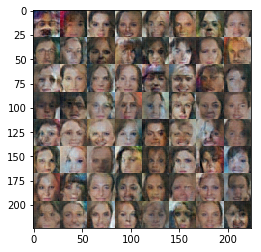

Epoch 4/4... Discriminator Loss: 1.6086... Generator Loss: 0.4374
Epoch 4/4... Discriminator Loss: 1.5452... Generator Loss: 0.4424
Epoch 4/4... Discriminator Loss: 1.7353... Generator Loss: 0.2997
Epoch 4/4... Discriminator Loss: 1.3248... Generator Loss: 0.7541
Epoch 4/4... Discriminator Loss: 1.7939... Generator Loss: 0.2354
Epoch 4/4... Discriminator Loss: 2.0847... Generator Loss: 0.1625
Epoch 4/4... Discriminator Loss: 1.5171... Generator Loss: 0.5542
Epoch 4/4... Discriminator Loss: 1.4299... Generator Loss: 0.4883
Epoch 4/4... Discriminator Loss: 2.0259... Generator Loss: 0.1743
Epoch 4/4... Discriminator Loss: 1.7848... Generator Loss: 0.2993


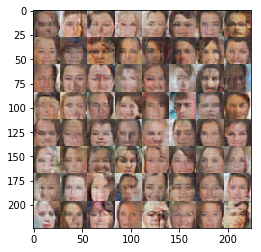

Epoch 4/4... Discriminator Loss: 1.5915... Generator Loss: 0.7354
Epoch 4/4... Discriminator Loss: 2.1298... Generator Loss: 0.4006
Epoch 4/4... Discriminator Loss: 1.9386... Generator Loss: 0.2016
Epoch 4/4... Discriminator Loss: 1.8307... Generator Loss: 0.2368
Epoch 4/4... Discriminator Loss: 1.8119... Generator Loss: 0.2870
Epoch 4/4... Discriminator Loss: 1.7283... Generator Loss: 0.2555
Epoch 4/4... Discriminator Loss: 1.4844... Generator Loss: 0.3864
Epoch 4/4... Discriminator Loss: 1.7096... Generator Loss: 0.5447
Epoch 4/4... Discriminator Loss: 1.4905... Generator Loss: 0.6721
Epoch 4/4... Discriminator Loss: 1.6422... Generator Loss: 0.5589


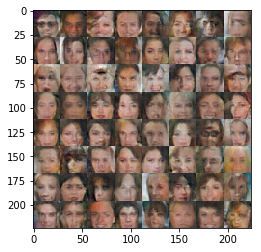

Epoch 4/4... Discriminator Loss: 1.5852... Generator Loss: 0.3979
Epoch 4/4... Discriminator Loss: 1.6084... Generator Loss: 0.3833
Epoch 4/4... Discriminator Loss: 1.7921... Generator Loss: 0.3345
Epoch 4/4... Discriminator Loss: 2.0309... Generator Loss: 0.5230
Epoch 4/4... Discriminator Loss: 1.4980... Generator Loss: 0.5059
Epoch 4/4... Discriminator Loss: 1.6685... Generator Loss: 0.4650
Epoch 4/4... Discriminator Loss: 1.5729... Generator Loss: 0.4636
Epoch 4/4... Discriminator Loss: 1.3781... Generator Loss: 0.7604
Epoch 4/4... Discriminator Loss: 1.6380... Generator Loss: 0.3932
Epoch 4/4... Discriminator Loss: 1.6264... Generator Loss: 0.3105


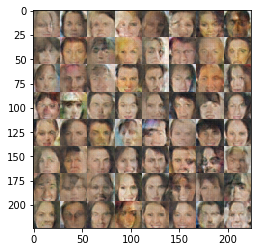

Epoch 4/4... Discriminator Loss: 1.8558... Generator Loss: 0.2270
Epoch 4/4... Discriminator Loss: 2.0375... Generator Loss: 0.1744
Epoch 4/4... Discriminator Loss: 1.6399... Generator Loss: 0.3709
Epoch 4/4... Discriminator Loss: 1.2792... Generator Loss: 0.4839
Epoch 4/4... Discriminator Loss: 1.8544... Generator Loss: 0.2355
Epoch 4/4... Discriminator Loss: 1.5302... Generator Loss: 0.3871
Epoch 4/4... Discriminator Loss: 1.5891... Generator Loss: 0.3768
Epoch 4/4... Discriminator Loss: 1.4157... Generator Loss: 0.4308
Epoch 4/4... Discriminator Loss: 1.6996... Generator Loss: 0.3252
Epoch 4/4... Discriminator Loss: 1.7086... Generator Loss: 0.4020


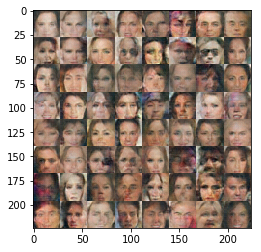

Epoch 4/4... Discriminator Loss: 1.7732... Generator Loss: 0.2446
Epoch 4/4... Discriminator Loss: 1.8122... Generator Loss: 0.2851
Epoch 4/4... Discriminator Loss: 1.3916... Generator Loss: 0.4908
Epoch 4/4... Discriminator Loss: 1.7919... Generator Loss: 0.5315
Epoch 4/4... Discriminator Loss: 1.7701... Generator Loss: 0.2957
Epoch 4/4... Discriminator Loss: 1.7069... Generator Loss: 0.2534
Epoch 4/4... Discriminator Loss: 1.7992... Generator Loss: 0.5758
Epoch 4/4... Discriminator Loss: 1.7465... Generator Loss: 0.6375
Epoch 4/4... Discriminator Loss: 1.2823... Generator Loss: 0.5191
Epoch 4/4... Discriminator Loss: 1.4345... Generator Loss: 0.5017


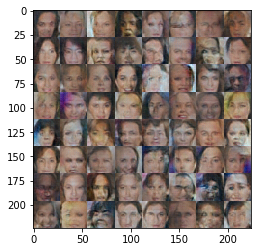

Epoch 4/4... Discriminator Loss: 1.8718... Generator Loss: 0.2076
Epoch 4/4... Discriminator Loss: 1.2950... Generator Loss: 0.7208
Epoch 4/4... Discriminator Loss: 2.0013... Generator Loss: 0.6764
Epoch 4/4... Discriminator Loss: 1.7311... Generator Loss: 0.2634
Epoch 4/4... Discriminator Loss: 1.4843... Generator Loss: 0.3673
Epoch 4/4... Discriminator Loss: 1.8460... Generator Loss: 0.2224
Epoch 4/4... Discriminator Loss: 1.6920... Generator Loss: 0.5248
Epoch 4/4... Discriminator Loss: 1.6746... Generator Loss: 0.5223
Epoch 4/4... Discriminator Loss: 1.8217... Generator Loss: 0.2491
Epoch 4/4... Discriminator Loss: 1.8784... Generator Loss: 0.2219


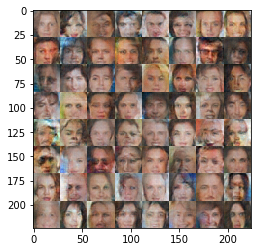

Epoch 4/4... Discriminator Loss: 1.8296... Generator Loss: 0.2139
Epoch 4/4... Discriminator Loss: 1.5928... Generator Loss: 0.3289
Epoch 4/4... Discriminator Loss: 1.5247... Generator Loss: 0.7888
Epoch 4/4... Discriminator Loss: 1.6349... Generator Loss: 0.4616
Epoch 4/4... Discriminator Loss: 1.8263... Generator Loss: 0.2185
Epoch 4/4... Discriminator Loss: 1.5263... Generator Loss: 0.3929
Epoch 4/4... Discriminator Loss: 1.6753... Generator Loss: 0.3696
Epoch 4/4... Discriminator Loss: 1.7296... Generator Loss: 0.4912
Epoch 4/4... Discriminator Loss: 1.5486... Generator Loss: 0.3050
Epoch 4/4... Discriminator Loss: 1.5364... Generator Loss: 0.6458


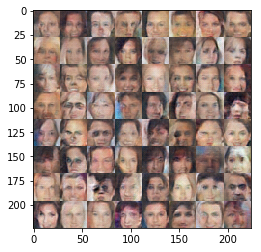

Epoch 4/4... Discriminator Loss: 2.0536... Generator Loss: 0.6820
Epoch 4/4... Discriminator Loss: 1.7661... Generator Loss: 0.2776
Epoch 4/4... Discriminator Loss: 1.7239... Generator Loss: 0.3871
Epoch 4/4... Discriminator Loss: 1.7402... Generator Loss: 0.2310
Epoch 4/4... Discriminator Loss: 1.6232... Generator Loss: 0.3033
Epoch 4/4... Discriminator Loss: 1.5013... Generator Loss: 0.6910
Epoch 4/4... Discriminator Loss: 1.5982... Generator Loss: 0.2854
Epoch 4/4... Discriminator Loss: 1.6143... Generator Loss: 0.3867
Epoch 4/4... Discriminator Loss: 1.8733... Generator Loss: 0.2477
Epoch 4/4... Discriminator Loss: 1.6939... Generator Loss: 0.2819


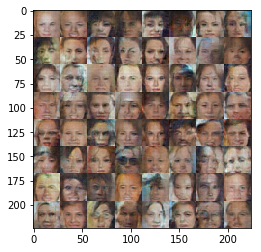

Epoch 4/4... Discriminator Loss: 1.6856... Generator Loss: 0.3007
Epoch 4/4... Discriminator Loss: 1.4337... Generator Loss: 0.4611
Epoch 4/4... Discriminator Loss: 1.6849... Generator Loss: 0.2862
Epoch 4/4... Discriminator Loss: 1.5901... Generator Loss: 0.3256
Epoch 4/4... Discriminator Loss: 1.7214... Generator Loss: 0.2638
Epoch 4/4... Discriminator Loss: 1.6020... Generator Loss: 0.3092
Epoch 4/4... Discriminator Loss: 1.4082... Generator Loss: 0.5402
Epoch 4/4... Discriminator Loss: 1.8809... Generator Loss: 0.2310
Epoch 4/4... Discriminator Loss: 1.8175... Generator Loss: 0.2533
Epoch 4/4... Discriminator Loss: 1.8049... Generator Loss: 0.4487


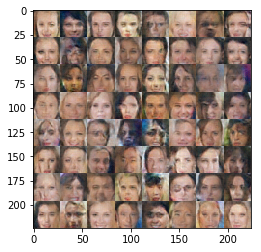

Epoch 4/4... Discriminator Loss: 2.1195... Generator Loss: 0.2885
Epoch 4/4... Discriminator Loss: 1.3862... Generator Loss: 0.4401
Epoch 4/4... Discriminator Loss: 1.5570... Generator Loss: 0.2950
Epoch 4/4... Discriminator Loss: 1.6537... Generator Loss: 0.2847
Epoch 4/4... Discriminator Loss: 1.4210... Generator Loss: 0.7087
Epoch 4/4... Discriminator Loss: 1.3118... Generator Loss: 0.8060
Epoch 4/4... Discriminator Loss: 1.3495... Generator Loss: 0.4497
Epoch 4/4... Discriminator Loss: 1.3800... Generator Loss: 0.6449
Epoch 4/4... Discriminator Loss: 1.7063... Generator Loss: 0.4723
Epoch 4/4... Discriminator Loss: 1.5588... Generator Loss: 0.5442


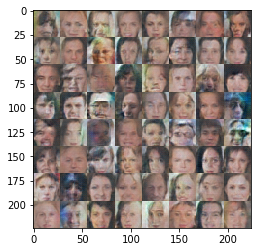

Epoch 4/4... Discriminator Loss: 1.2363... Generator Loss: 0.5064
Epoch 4/4... Discriminator Loss: 1.5585... Generator Loss: 0.6686
Epoch 4/4... Discriminator Loss: 1.5894... Generator Loss: 0.3120
Epoch 4/4... Discriminator Loss: 1.7863... Generator Loss: 0.2181
Epoch 4/4... Discriminator Loss: 1.6145... Generator Loss: 0.3201
Epoch 4/4... Discriminator Loss: 1.6511... Generator Loss: 0.5744
Epoch 4/4... Discriminator Loss: 1.4873... Generator Loss: 0.8493
Epoch 4/4... Discriminator Loss: 1.7114... Generator Loss: 0.7836
Epoch 4/4... Discriminator Loss: 1.5508... Generator Loss: 0.4396
Epoch 4/4... Discriminator Loss: 1.9609... Generator Loss: 0.2219


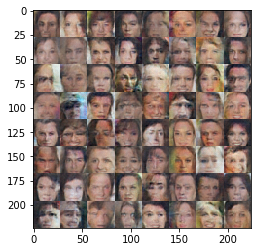

Epoch 4/4... Discriminator Loss: 1.6831... Generator Loss: 0.2452
Epoch 4/4... Discriminator Loss: 1.3850... Generator Loss: 0.5638
Epoch 4/4... Discriminator Loss: 1.7381... Generator Loss: 0.6271
Epoch 4/4... Discriminator Loss: 1.0335... Generator Loss: 0.7647
Epoch 4/4... Discriminator Loss: 1.4329... Generator Loss: 0.4396
Epoch 4/4... Discriminator Loss: 1.6408... Generator Loss: 0.3120
Epoch 4/4... Discriminator Loss: 1.7252... Generator Loss: 0.2670
Epoch 4/4... Discriminator Loss: 1.7457... Generator Loss: 0.2710
Epoch 4/4... Discriminator Loss: 2.1102... Generator Loss: 0.1820
Epoch 4/4... Discriminator Loss: 1.3986... Generator Loss: 0.4402


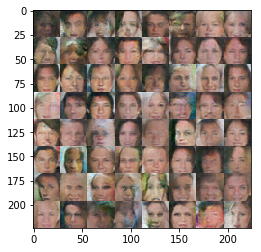

Epoch 4/4... Discriminator Loss: 1.5614... Generator Loss: 0.4937
Epoch 4/4... Discriminator Loss: 1.4903... Generator Loss: 0.5255
Epoch 4/4... Discriminator Loss: 1.5055... Generator Loss: 0.3102
Epoch 4/4... Discriminator Loss: 1.8442... Generator Loss: 0.2588
Epoch 4/4... Discriminator Loss: 1.5879... Generator Loss: 0.3431
Epoch 4/4... Discriminator Loss: 1.5194... Generator Loss: 0.6120
Epoch 4/4... Discriminator Loss: 1.3913... Generator Loss: 0.8854
Epoch 4/4... Discriminator Loss: 1.4691... Generator Loss: 0.3800
Epoch 4/4... Discriminator Loss: 1.8065... Generator Loss: 0.2694
Epoch 4/4... Discriminator Loss: 1.7612... Generator Loss: 0.3625


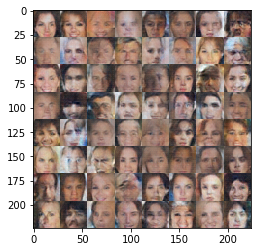

Epoch 4/4... Discriminator Loss: 1.5457... Generator Loss: 1.1530
Epoch 4/4... Discriminator Loss: 1.7728... Generator Loss: 0.2763
Epoch 4/4... Discriminator Loss: 1.4409... Generator Loss: 0.5996
Epoch 4/4... Discriminator Loss: 1.3568... Generator Loss: 0.5441
Epoch 4/4... Discriminator Loss: 1.4909... Generator Loss: 0.3155
Epoch 4/4... Discriminator Loss: 1.4566... Generator Loss: 0.6388
Epoch 4/4... Discriminator Loss: 1.6205... Generator Loss: 0.3920
Epoch 4/4... Discriminator Loss: 1.8332... Generator Loss: 0.4262
Epoch 4/4... Discriminator Loss: 1.9417... Generator Loss: 0.1902
Epoch 4/4... Discriminator Loss: 1.5970... Generator Loss: 0.2898


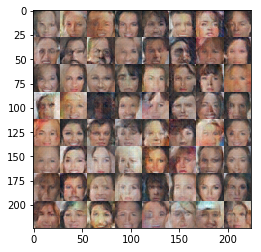

Epoch 4/4... Discriminator Loss: 1.5279... Generator Loss: 0.4747
Epoch 4/4... Discriminator Loss: 1.7065... Generator Loss: 0.2623
Epoch 4/4... Discriminator Loss: 1.7556... Generator Loss: 0.2609
Epoch 4/4... Discriminator Loss: 1.4584... Generator Loss: 0.6246
Epoch 4/4... Discriminator Loss: 1.7338... Generator Loss: 0.8182
Epoch 4/4... Discriminator Loss: 1.5622... Generator Loss: 0.4201
Epoch 4/4... Discriminator Loss: 1.6116... Generator Loss: 0.2801
Epoch 4/4... Discriminator Loss: 1.6920... Generator Loss: 0.3561
Epoch 4/4... Discriminator Loss: 1.6892... Generator Loss: 0.2673
Epoch 4/4... Discriminator Loss: 1.6486... Generator Loss: 0.2729


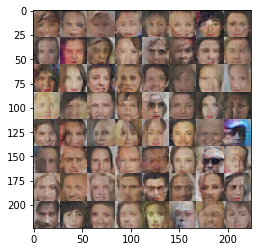

Epoch 4/4... Discriminator Loss: 1.5500... Generator Loss: 0.3599
Epoch 4/4... Discriminator Loss: 1.8028... Generator Loss: 0.2586
Epoch 4/4... Discriminator Loss: 1.3459... Generator Loss: 0.7139
Epoch 4/4... Discriminator Loss: 1.6651... Generator Loss: 0.4541
Epoch 4/4... Discriminator Loss: 1.6621... Generator Loss: 0.4519
Epoch 4/4... Discriminator Loss: 1.7784... Generator Loss: 0.3242
Epoch 4/4... Discriminator Loss: 1.8905... Generator Loss: 0.2352
Epoch 4/4... Discriminator Loss: 1.2921... Generator Loss: 0.7375
Epoch 4/4... Discriminator Loss: 1.6238... Generator Loss: 0.3071
Epoch 4/4... Discriminator Loss: 1.6085... Generator Loss: 0.2745


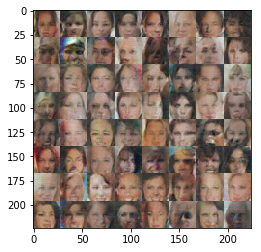

Epoch 4/4... Discriminator Loss: 1.6726... Generator Loss: 0.3439
Epoch 4/4... Discriminator Loss: 1.7128... Generator Loss: 0.2838
Epoch 4/4... Discriminator Loss: 1.9708... Generator Loss: 0.2066
Epoch 4/4... Discriminator Loss: 1.3865... Generator Loss: 0.8871
Epoch 4/4... Discriminator Loss: 1.3816... Generator Loss: 0.8630
Epoch 4/4... Discriminator Loss: 1.8692... Generator Loss: 0.2863
Epoch 4/4... Discriminator Loss: 1.6218... Generator Loss: 0.3282
Epoch 4/4... Discriminator Loss: 1.4260... Generator Loss: 0.6748
Epoch 4/4... Discriminator Loss: 1.6072... Generator Loss: 0.3127
Epoch 4/4... Discriminator Loss: 1.6491... Generator Loss: 0.3192


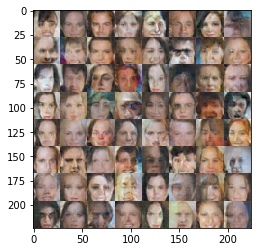

Epoch 4/4... Discriminator Loss: 1.5534... Generator Loss: 0.3451
Epoch 4/4... Discriminator Loss: 1.3334... Generator Loss: 0.6744
Epoch 4/4... Discriminator Loss: 1.7109... Generator Loss: 0.3874
Epoch 4/4... Discriminator Loss: 1.7257... Generator Loss: 0.3269
Epoch 4/4... Discriminator Loss: 1.3905... Generator Loss: 0.4020
Epoch 4/4... Discriminator Loss: 1.6950... Generator Loss: 0.2602
Epoch 4/4... Discriminator Loss: 1.7498... Generator Loss: 0.2300
Epoch 4/4... Discriminator Loss: 1.9654... Generator Loss: 0.2099
Epoch 4/4... Discriminator Loss: 1.7976... Generator Loss: 0.2973
Epoch 4/4... Discriminator Loss: 1.6604... Generator Loss: 0.2653


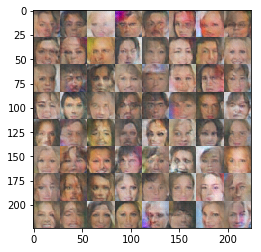

Epoch 4/4... Discriminator Loss: 1.7530... Generator Loss: 0.2865
Epoch 4/4... Discriminator Loss: 1.5403... Generator Loss: 0.4660
Epoch 4/4... Discriminator Loss: 1.5041... Generator Loss: 0.4109
Epoch 4/4... Discriminator Loss: 1.4478... Generator Loss: 0.7130
Epoch 4/4... Discriminator Loss: 2.0362... Generator Loss: 0.4625
Epoch 4/4... Discriminator Loss: 1.6848... Generator Loss: 0.3059
Epoch 4/4... Discriminator Loss: 1.6741... Generator Loss: 0.4643
Epoch 4/4... Discriminator Loss: 1.9686... Generator Loss: 0.2552
Epoch 4/4... Discriminator Loss: 1.3099... Generator Loss: 0.9233
Epoch 4/4... Discriminator Loss: 1.4801... Generator Loss: 0.3887


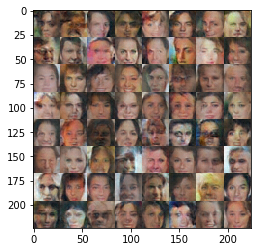

Epoch 4/4... Discriminator Loss: 1.7305... Generator Loss: 0.2884
Epoch 4/4... Discriminator Loss: 1.7672... Generator Loss: 0.4678
Epoch 4/4... Discriminator Loss: 1.5448... Generator Loss: 0.3831
Epoch 4/4... Discriminator Loss: 1.6263... Generator Loss: 0.2956
Epoch 4/4... Discriminator Loss: 1.6069... Generator Loss: 0.4034
Epoch 4/4... Discriminator Loss: 1.7762... Generator Loss: 0.3765
Epoch 4/4... Discriminator Loss: 1.7239... Generator Loss: 0.4203
Epoch 4/4... Discriminator Loss: 1.4459... Generator Loss: 0.4704
Epoch 4/4... Discriminator Loss: 1.5918... Generator Loss: 0.3716
Epoch 4/4... Discriminator Loss: 1.4724... Generator Loss: 0.5197


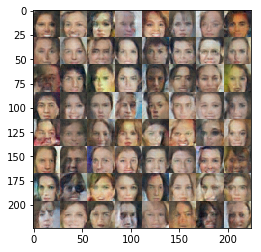

Epoch 4/4... Discriminator Loss: 1.5724... Generator Loss: 0.3602
Epoch 4/4... Discriminator Loss: 1.5339... Generator Loss: 0.3717
Epoch 4/4... Discriminator Loss: 1.5118... Generator Loss: 0.3272
Epoch 4/4... Discriminator Loss: 1.4482... Generator Loss: 0.9192
Epoch 4/4... Discriminator Loss: 1.6898... Generator Loss: 0.3842
Epoch 4/4... Discriminator Loss: 1.7007... Generator Loss: 0.3737


In [19]:
batch_size = 64
z_dim = 200
learning_rate = 0.001
beta1 = 0.3


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 4

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

In [20]:
print('done')

done


### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.